In [1]:
import scanpy as sc
import numpy as np
import pandas as pd

import matplotlib.pyplot as plt
import seaborn as sns

import json
import pathlib as pl
import anndata as ad
import geopandas as gpd
from shapely.geometry import Point
import os
import math

import tifffile

In [2]:
import matplotlib
matplotlib.rcParams['svg.fonttype'] = 'none'

# Import and preprocess data

## Helper functions

In [3]:
def guess_label_column(gdf: gpd.GeoDataFrame) -> str | None:
    """Pick a reasonable label column from common QuPath exports."""
    candidates = [
        "classification_name",  # from nested 'classification.name'
        "name",
        "label",
        "annotation",
        "class",
        "type",
    ]
    cols = [c for c in gdf.columns if c != gdf.geometry.name]
    for c in candidates:
        if c in cols:
            return c
    return cols[0] if cols else None


def ensure_label_column(gdf: gpd.GeoDataFrame, prefer: str | None) -> str | None:
    """Ensure there's a flat text label column to use."""
    if prefer and prefer in gdf.columns:
        return prefer

    # Some QuPath exports store nested dict in 'classification' with key 'name'
    if "classification" in gdf.columns and "classification_name" not in gdf.columns:
        def _extract_name(v):
            try:
                if isinstance(v, dict):
                    return v.get("name")
                if isinstance(v, str):
                    return json.loads(v).get("name")
            except Exception:
                pass
            return None
        gdf["classification_name"] = gdf["classification"].map(_extract_name)

    return guess_label_column(gdf)


def make_points_gdf(XY: np.ndarray, index, crs) -> gpd.GeoDataFrame:
    """Create a GeoDataFrame of points from (x, y) coordinates."""
    points = gpd.GeoSeries((Point(float(x), float(y)) for x, y in XY),
                           index=index, name="geometry", crs=crs)
    return gpd.GeoDataFrame(geometry=points)


def aggregate_labels(join_df: pd.DataFrame, label_col: str, obs_index) -> pd.Series:
    """Aggregate multiple matches per cell into a semicolon-separated label string."""
    if label_col not in join_df.columns:
        s = join_df.index.to_series().groupby(level=0).size()
        out = pd.Series(index=obs_index, dtype="object")
        out.loc[s.index] = "in_annotation"
        return out

    agg = (
        join_df[label_col]
        .groupby(level=0)
        .apply(lambda s: ";".join(sorted(str(v) for v in set(s.dropna()))))
    )
    out = pd.Series(index=obs_index, dtype="object")
    out.loc[agg.index] = agg
    return out


In [4]:
def build_palettes_from_adata(adata, palette_specs):
    """
    Build labeled color palettes for categorical columns in adata.obs.

    Parameters
    ----------
    adata : AnnData
        Must have .obs DataFrame containing categorical columns.
    palette_specs : dict
        Mapping {column_name: palette} where palette can be:
          - a string palette name (e.g. "tab10")
          - a list of RGB colors (custom)

    Returns
    -------
    dict
        {column_name: {label: color}} mapping.
    """
    custom_palettes = {}

    for col, palette in palette_specs.items():
        if col not in adata.obs.columns:
            print(f"⚠️ Warning: '{col}' not found in adata.obs — skipping.")
            continue

        unique_vals = sorted(adata.obs[col].astype(str).dropna().unique())
        n_unique = len(unique_vals)

        # If user passed a name → generate via seaborn
        if isinstance(palette, str):
            pal_colors = sns.color_palette(palette, n_colors=n_unique)
        # If user passed a list → use directly
        elif isinstance(palette, (list, tuple)):
            pal_colors = palette[:n_unique]
        else:
            raise ValueError(f"Unsupported palette type for '{col}': {type(palette)}")

        color_dict = dict(zip(unique_vals, pal_colors))
        custom_palettes[col] = color_dict

    print(f"✅ Built palettes for {len(custom_palettes)} columns.")
    return custom_palettes


In [5]:
def plot_celltype_spatial_single_split_legend(
    df,
    color_by="celltype",
    sample_id=None,
    title=None,
    palette_dict=None,         # ✅ added
    palette_name="tab20",
    s=1.5,
    save_svg=True,
    output_prefix="spatial_plot",
    legend_title=None,
):
    """
    Nature Genetics–style spatial scatterplot for one sample,
    saving main plot as PNG (raster) and legend separately as SVG (vector).
    """
    sns.set_style("white")
    sns.set_context("talk")

    # --- Subset one sample ---
    if sample_id is not None:
        df = df[df["sample_id"] == sample_id].copy()
        if df.empty:
            raise ValueError(f"Sample ID '{sample_id}' not found in DataFrame.")

    # --- Colors ---
    unique_labels = sorted(df[color_by].dropna().unique())
    if palette_dict is not None and color_by in palette_dict:
        color_dict = palette_dict[color_by]
    else:
        palette = sns.color_palette(palette_name, n_colors=len(unique_labels))
        color_dict = dict(zip(unique_labels, palette))

    # --- Main plot ---
    fig, ax = plt.subplots(figsize=(6, 5), dpi=300)
    sns.scatterplot(
        data=df,
        x="X_coord", y="Y_coord",
        hue=color_by, palette=color_dict,
        s=s, alpha=0.9, linewidth=0,
        rasterized=True, ax=ax, legend=False
    )
    ax.invert_yaxis(); ax.set_aspect("equal", adjustable="box")
    for spine in ["top", "right", "left", "bottom"]:
        ax.spines[spine].set_visible(False)
    ax.set_xticks([]); ax.set_yticks([])
    ax.set_xlabel(""); ax.set_ylabel("")
    plt.tight_layout()

    # --- Save main figure ---
    fname_main = f"{output_prefix}_{sample_id or 'sample'}_main.png"
    fig.savefig(fname_main, dpi=300, bbox_inches="tight", transparent=True, format="png")
    print(f"Saved main figure: {fname_main}")

    # --- Legend ---
    fig_leg, ax_leg = plt.subplots(figsize=(3, 0.5 * len(unique_labels)), dpi=300)
    handles = [
        plt.Line2D([0], [0], marker='o', color='none', label=label,
                   markerfacecolor=color_dict[label], markersize=8)
        for label in unique_labels
    ]
    ax_leg.legend(handles=handles, loc="center left", frameon=False,
                  title=legend_title or color_by, title_fontsize=14, fontsize=14)
    ax_leg.axis("off")
    plt.tight_layout()

    if save_svg:
        fname_leg = f"{output_prefix}_{sample_id or 'sample'}_legend.svg"
        fig_leg.savefig(fname_leg, dpi=300, bbox_inches="tight", transparent=True, format="svg")
        print(f"Saved legend: {fname_leg}")

    plt.close(fig); plt.close(fig_leg)


## Analysis

In [63]:
# --- REQUIRED: set your paths ---
ADATA_PATH = '../../../Broad_SpatialFoundation/hest_processed_data/TENX157/adata.h5ad'
GEOJSON_PATH = "../../../Broad_SpatialFoundation/hest_processed_data/TENX157/Xenium_Prime_Human_Prostate_FFPE_he_image.geojson"

# --- OPTIONAL: customize these ---
OBSM_KEY   = "spatial_he"                         # obsm key with (x, y) in H&E pixel space
OUT_PATH   = None                                 # None -> will save next to ADATA_PATH with .annotated.h5ad
OUT_COL    = "region_annotation"                  # adata.obs column to write labels into
LABEL_COL  = 'name'                                 # if you know your label field name in the GeoJSON, set it (e.g., "name")
                                                   # otherwise the notebook tries to guess it

In [64]:
rawdata = sc.read_h5ad(ADATA_PATH)

In [65]:
cell_types = pd.read_csv('../../../Broad_SpatialFoundation/hest_processed_data/TENX157/celltypes.csv', index_col=0)

rawdata.obs = pd.concat([rawdata.obs, cell_types],axis=1)

In [66]:
XY = np.asarray(rawdata.obsm[OBSM_KEY])

In [67]:
ann = gpd.read_file(GEOJSON_PATH)
if ann.empty:
    raise ValueError("Annotation GeoJSON has no geometries.")

ann = ann[ann.geometry.notnull()].copy()
ann = ann[ann.geometry.geom_type.isin(["Polygon", "MultiPolygon"])].copy()
if ann.empty:
    raise ValueError("No Polygon/MultiPolygon geometries found in the GeoJSON.")

label_col = ensure_label_column(ann, LABEL_COL)
if label_col is None:
    label_col = "_layer"
    ann[label_col] = "annotation"

print("Annotation label column:", label_col)
display(ann.head())


Skipping field color: unsupported OGR type: 1


Annotation label column: name


,id,objectType,name,classification,geometry
0,9e55e7c3-741e-480f-a9d4-c6d0776ce961,annotation,Adipose tissue,"{ ""name"": ""Other"", ""color"": [ 255, 200, 0 ] }","POLYGON ((6123 9346, 6123.11 9347.01, 6123 934..."
1,f8b5245f-0d63-400b-b19f-5135cb0f60d9,annotation,Nerve,"{ ""name"": ""Other"", ""color"": [ 255, 200, 0 ] }","POLYGON ((6274 8192, 6274 8205, 6274 8218, 627..."
2,ff83304c-29ca-4492-8000-8ff67ff216c8,annotation,Normal prostate glands,"{ ""name"": ""Other"", ""color"": [ 255, 200, 0 ] }","POLYGON ((19369 46479, 19392 46479, 19406 4648..."
3,42b166f9-e8f6-45f4-a774-0cd0985d797e,annotation,Normal prostate tissue,None,"POLYGON ((21902.18 39610, 21900 39613, 21899 3..."
4,9fadf924-9d84-45d5-81f9-4384b8c4d6b5,annotation,skin,None,"POLYGON ((0 15038.63, 0 15042.04, 0 15279.6, 0..."


In [68]:
# Make sure CRS aligns; QuPath pixel coords commonly have no CRS, which is fine
pts = make_points_gdf(XY, rawdata.obs_names, crs=ann.crs)

# Join with predicate='within' (Shapely 2+ / GeoPandas >=0.10)
joined = gpd.sjoin(pts, ann[[label_col, ann.geometry.name]], how="left", predicate="within")

# Aggregate overlaps and fill missing
labels = aggregate_labels(joined, label_col, obs_index=rawdata.obs_names).fillna("unlabeled")
rawdata.obs[OUT_COL] = pd.Categorical(labels)

print("Done assigning labels. Preview value counts:")
display(rawdata.obs[OUT_COL].value_counts(dropna=False).to_frame("count"))


Done assigning labels. Preview value counts:


,count
region_annotation,
Prostate tumor,140941
,27731
Normal prostate glands,20215
Adipose tissue,1951
Normal prostate tissue,874
Inflammatory cells;Prostate tumor,280
Inflammatory cells,269
Nerve,174
Prostate tumor;inflammatory cells,94


In [69]:
rawdata.obs[OUT_COL] = rawdata.obs[OUT_COL].replace({'': 'Unassigned', 'Inflammatory cells;Prostate tumor': 'Inflammatory cells',
                              'Prostate tumor;inflammatory cells': 'Inflammatory cells',
                                                     'Normal prostate glands': 'Normal prostate tissue',
                              'Normal prostate glands;Prostate tumor': 'Normal prostate tissue',
                              'Normal prostate tissue;Prostate tumor': 'Normal prostate tissue'})

/tmp/ipykernel_2452665/3380695288.py:1: FutureWarning: The behavior of Series.replace (and DataFrame.replace) with CategoricalDtype is deprecated. In a future version, replace will only be used for cases that preserve the categories. To change the categories, use ser.cat.rename_categories instead.
  rawdata.obs[OUT_COL] = rawdata.obs[OUT_COL].replace({'': 'Unassigned', 'Inflammatory cells;Prostate tumor': 'Inflammatory cells',


In [70]:
rawdata.obs = pd.concat([rawdata.obs, pd.DataFrame(rawdata.obsm['spatial_he'], index=rawdata.obs_names, columns=['X_coord','Y_coord'])],axis=1)

In [71]:
rawdata = rawdata[rawdata.obs.region_annotation!='skin'].copy()

In [77]:
rawdata = rawdata[rawdata.obs.dropna().index]

In [15]:
region_df = rawdata.obs[['cellsubtypes', 'celltypes',\
       'region_annotation', 'X_coord','Y_coord']]

region_df['sample_id'] = 'TENX157'

In [16]:
tab_filtered = sns.color_palette()
tab_filtered = [c for i,c in enumerate(tab_filtered) if i not in [4,6]]

tab20_filtered = sns.color_palette('tab20') + sns.color_palette('tab20c')[:11]
tab20_filtered = [c for i,c in enumerate(tab20_filtered) if i not in [8,9,12,13]]

In [17]:
palette_specs = {
            "region_annotation": tab_filtered,
            "celltypes": tab_filtered,
            "cellsubtypes": tab20_filtered,
        }

palette_dict_1 = build_palettes_from_adata(rawdata, palette_specs)

✅ Built palettes for 3 columns.


In [18]:
cpal = sns.color_palette()
palette_dict_1['major_celltype'] = {'Malignant': cpal[0], 'Mesenchymal': cpal[1], 'Myeloid': cpal[2],
                  'Epithelial': cpal[3], 'Endothelial': cpal[5], 'Lymphoid': cpal[9],}

In [19]:
plot_celltype_spatial_single_split_legend(
    region_df,
    color_by="celltypes",
    sample_id=None,
    title='PRAD\nCell type',
    palette_dict=palette_dict_1,
    s=1.5,
    save_svg=True,
    output_prefix="../../../SpatialFusion/results/figures_Fig4/PRAD_celltype",
    legend_title='Cell Type'
)

Saved main figure: /ewsc/yatesjos/SpatialFusion/results/figures_Fig4/PRAD_celltype_sample_main.png
Saved legend: /ewsc/yatesjos/SpatialFusion/results/figures_Fig4/PRAD_celltype_sample_legend.svg


In [64]:
plot_celltype_spatial_single_split_legend(
    region_df,
    color_by="cellsubtypes",
    sample_id=None,
    title='PRAD\nCell subtype',
    palette_dict=palette_dict_1,
    s=1.5,
    save_svg=True,
    output_prefix="../../../SpatialFusion/results/figures_Fig4/PRAD_cellsubtype",
    legend_title='Cell Subtype'
)

Saved main figure: /ewsc/yatesjos/SpatialFusion/results/figures_Fig4/PRAD_cellsubtype_sample_main.png
Saved legend: /ewsc/yatesjos/SpatialFusion/results/figures_Fig4/PRAD_cellsubtype_sample_legend.svg


In [65]:
plot_celltype_spatial_single_split_legend(
    region_df,
    color_by="region_annotation",
    sample_id=None,
    title='PRAD\nPathologist-annotated region',
    palette_dict=palette_dict_1,
    s=1.5,
    save_svg=True,
    output_prefix="../../../SpatialFusion/results/figures_Fig4/PRAD_pathregion",
    legend_title='Path.-annotated region'
)

Saved main figure: /ewsc/yatesjos/SpatialFusion/results/figures_Fig4/PRAD_pathregion_sample_main.png
Saved legend: /ewsc/yatesjos/SpatialFusion/results/figures_Fig4/PRAD_pathregion_sample_legend.svg


## Download estimated pathways

In [22]:
from spatialfusion.embed.embed import AEInputs, run_full_embedding

In [20]:
pathway_matrix = pd.read_parquet('../../../Broad_SpatialFoundation/hest_processed_data/TENX157/pathway_activation.parquet')

In [23]:
basepath = pl.Path('../../../Broad_SpatialFoundation/hest_processed_data/')
sample_name = 'TENX157'
output_dir = basepath / sample_name

In [24]:
uni_df = pd.read_csv(pl.Path(output_dir) / 'embeddings' / 'UNI.csv', index_col=0)
scgpt_df = pd.read_csv(pl.Path(output_dir) / 'embeddings' / 'scGPT.csv', index_col=0)

In [25]:
adata = sc.read_h5ad(basepath / sample_name / 'adata.h5ad')
adata.obs = pd.concat([adata.obs, pd.DataFrame(adata.obsm['spatial_he'], index=adata.obs_names, columns=['X_coord','Y_coord'])],axis=1)
adata.obs["sample_id"] = sample_name
cell_types = pd.read_csv(basepath / sample_name / 'celltypes.csv', index_col=0)
adata.obs = pd.concat([adata.obs, cell_types],axis=1)

In [26]:
ae_inputs_by_sample = {
    sample_name: AEInputs(adata=adata, z_uni=uni_df, z_scgpt=scgpt_df),
}

## Embedding average

In [27]:
# this uses the average version
embeddings_df = run_full_embedding(
    ae_inputs_by_sample=ae_inputs_by_sample,
    ae_model_path='../../../Broad_SpatialFoundation/checkpoint_dir_ae/paired_model_6c22d731.pt',
    gcn_model_path='../../../Broad_SpatialFoundation/checkpoint_dir_gcn/gcn_20250828-123835_e926ee8d/model.pt',
    device="cuda:0",
    combine_mode="average",
    spatial_key='spatial_he',
    celltype_key='celltypes',
    save_ae_dir=None,  # optional
)

Running GCN inference: 100%|███████████████████████████████████| 1/1 [00:00<00:00,  4.72it/s]


In [28]:
embeddings_df.index = embeddings_df.cell_id

out_path = pl.Path("../../../Broad_SpatialFoundation/hest_processed_data/TENX157/embeddings/NicheFinder_new.parquet")
embeddings_df.to_parquet(out_path)

/ewsc/yatesjos/spatialfusion_env/lib/python3.10/site-packages/pandas/io/parquet.py:191: UserWarning: The DataFrame has column names of mixed type. They will be converted to strings and not roundtrip correctly.
  table = self.api.Table.from_pandas(df, **from_pandas_kwargs)


## Embedding H&E only

In [29]:
# this uses the average version
embeddings_df = run_full_embedding(
    ae_inputs_by_sample=ae_inputs_by_sample,
    ae_model_path='../../../Broad_SpatialFoundation/checkpoint_dir_ae/paired_model_6c22d731.pt',
    gcn_model_path='../../../Broad_SpatialFoundation/checkpoint_dir_gcn/gcn_20251001-102239_fa6fe395/model.pt',
    device="cuda:0",
    combine_mode="z1",
    spatial_key='spatial_he',
    celltype_key='celltypes',
    save_ae_dir=None,  # optional
)

Running GCN inference: 100%|███████████████████████████████████| 1/1 [00:00<00:00, 10.36it/s]


In [30]:
embeddings_df.index = embeddings_df.cell_id

out_path = pl.Path("../../../Broad_SpatialFoundation/hest_processed_data/TENX157/embeddings/NicheFinder_he_new.parquet")
embeddings_df.to_parquet(out_path)

/ewsc/yatesjos/spatialfusion_env/lib/python3.10/site-packages/pandas/io/parquet.py:191: UserWarning: The DataFrame has column names of mixed type. They will be converted to strings and not roundtrip correctly.
  table = self.api.Table.from_pandas(df, **from_pandas_kwargs)


# Finetuned model

In [39]:
from spatialfusion.finetune.finetune import finetune_models

In [40]:
adatas = {sample_name: adata}

preloaded_data = {
    sample_name: (uni_df.loc[adata.obs_names], scgpt_df.loc[adata.obs_names])
}

preloaded_pathway_data = {
    sample_name: pathway_matrix.loc[adata.obs_names]
}

In [41]:
finetune_models(
    samples=[sample_name],
    pretrained_ae='../../../Broad_SpatialFoundation/checkpoint_dir_ae/paired_model_6c22d731.pt',
    pretrained_gcn='../../../Broad_SpatialFoundation/checkpoint_dir_gcn/gcn_20250828-123835_e926ee8d/model.pt',
    save_dir='../../../Broad_SpatialFoundation/finetuned_PRAD',
    preloaded_data=preloaded_data,   
    adatas=adatas,                  
    preloaded_pathway_data=preloaded_pathway_data,
    ae_epochs=5,
    gcn_epochs=10,
    ae_batch_size=128,
    gcn_batch_size=2,
    latent_dim=64,
    knn_k=30,
    subgraph_size=5000,
    stride=2500,
    use_cls_loss=True,
    spatial_key='spatial_he',
)


[AE 1] total=0.8790


[AE 2] total=0.8102


[AE 3] total=0.7864


[AE 4] total=0.7712


[AE 5] total=0.7602
[TENX157] Using preloaded pathway activation data.
[TENX157] Attached 10 label dimensions.


[GCN 1] total=1.3307


[GCN 2] total=1.3290


[GCN 3] total=1.3217


[GCN 4] total=1.3156


[GCN 5] total=1.3065


[GCN 6] total=1.3043


[GCN 7] total=1.3014


[GCN 8] total=1.2942


[GCN 9] total=1.2998


[GCN 10] total=1.2919
✓ Finetuning complete.


(PairedAE(
   (encoder1): EncoderAE(
     (model): Sequential(
       (0): Linear(in_features=1536, out_features=64, bias=True)
       (1): ReLU()
       (2): Linear(in_features=64, out_features=64, bias=True)
     )
   )
   (encoder2): EncoderAE(
     (model): Sequential(
       (0): Linear(in_features=512, out_features=64, bias=True)
       (1): ReLU()
       (2): Linear(in_features=64, out_features=64, bias=True)
     )
   )
   (decoder1): Decoder(
     (net): Sequential(
       (0): Linear(in_features=64, out_features=64, bias=True)
       (1): ReLU()
       (2): Linear(in_features=64, out_features=1536, bias=True)
     )
   )
   (decoder2): Decoder(
     (net): Sequential(
       (0): Linear(in_features=64, out_features=64, bias=True)
       (1): ReLU()
       (2): Linear(in_features=64, out_features=512, bias=True)
     )
   )
 ),
 GCNAutoencoder(
   (gcn_layers): ModuleList(
     (0): GraphConv(in=64, out=10, normalization=both, activation=None)
     (1): GraphConv(in=10, out=10

## Now embed finetune

In [42]:
basepath = pl.Path('../../../Broad_SpatialFoundation/hest_processed_data/')
sample_name = 'TENX157'
output_dir = basepath / sample_name

In [24]:
uni_df = pd.read_csv(pl.Path(output_dir) / 'embeddings' / 'UNI.csv', index_col=0)
scgpt_df = pd.read_csv(pl.Path(output_dir) / 'embeddings' / 'scGPT.csv', index_col=0)

In [43]:
adata = sc.read_h5ad(basepath / sample_name / 'adata.h5ad')
adata.obs = pd.concat([adata.obs, pd.DataFrame(adata.obsm['spatial_he'], index=adata.obs_names, columns=['X_coord','Y_coord'])],axis=1)
adata.obs["sample_id"] = sample_name
cell_types = pd.read_csv(basepath / sample_name / 'celltypes.csv', index_col=0)
adata.obs = pd.concat([adata.obs, cell_types],axis=1)

In [44]:
ae_inputs_by_sample = {
    sample_name: AEInputs(adata=adata, z_uni=uni_df, z_scgpt=scgpt_df),
}

In [45]:
# this uses the average version
embeddings_df = run_full_embedding(
    ae_inputs_by_sample=ae_inputs_by_sample,
    ae_model_path='../../../Broad_SpatialFoundation/finetuned_PRAD/paired_model_finetuned.pt',
    gcn_model_path='../../../Broad_SpatialFoundation/finetuned_PRAD/gcn_finetuned/model.pt',
    device="cuda:0",
    combine_mode="average",
    spatial_key='spatial_he',
    celltype_key=None,
    save_ae_dir=None,  # optional
)

Running GCN inference: 100%|███████████████████████████████████| 1/1 [00:00<00:00, 10.53it/s]


In [46]:
embeddings_df.index = embeddings_df.cell_id

out_path = pl.Path(output_dir / "embeddings"/ "NicheFinder_finetuned_new.parquet")
embeddings_df.to_parquet(out_path)

/ewsc/yatesjos/spatialfusion_env/lib/python3.10/site-packages/pandas/io/parquet.py:191: UserWarning: The DataFrame has column names of mixed type. They will be converted to strings and not roundtrip correctly.
  table = self.api.Table.from_pandas(df, **from_pandas_kwargs)


# SDMBench

## Helper functions

In [108]:
import numpy as np
import pandas as pd
from tqdm import tqdm

import scanpy as sc

from scipy.spatial import distance
from sklearn.neighbors import NearestNeighbors
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import *


In [109]:
def compute_PAS_fast(clusterlabel, location, k=10):
    clusterlabel = np.array(clusterlabel)
    location = np.array(location)

    # Fit NearestNeighbors (ignore self-match later)
    nbrs = NearestNeighbors(n_neighbors=k+1, algorithm='auto').fit(location)
    distances, indices = nbrs.kneighbors(location)

    # Remove self (first column is self in most cases)
    neighbor_indices = indices[:, 1:]  # shape: (n_samples, k)

    # Check PAS condition
    mismatches = np.array([
        np.sum(clusterlabel[neighbor_indices[i]] != clusterlabel[i]) > (k / 2)
        for i in range(len(clusterlabel))
    ])

    return np.sum(mismatches) / len(clusterlabel)


def compute_CHAOS_fast(clusterlabel, location):
    clusterlabel = np.array(clusterlabel)
    location = np.array(location)
    matched_location = StandardScaler().fit_transform(location)

    clusterlabel_unique = np.unique(clusterlabel)
    dist_val = 0
    total_count = 0

    for k in tqdm(clusterlabel_unique, desc="Computing CHAOS"):
        cluster_mask = clusterlabel == k
        location_cluster = matched_location[cluster_mask]
        n = location_cluster.shape[0]

        if n <= 2:
            continue

        # Use NearestNeighbors to find 1-NN distances
        nbrs = NearestNeighbors(n_neighbors=2, algorithm='auto').fit(location_cluster)
        distances, _ = nbrs.kneighbors(location_cluster)

        # distances[:, 0] is zero (self), distances[:, 1] is nearest neighbor
        dist_val += np.sum(distances[:, 1])
        total_count += n

    return dist_val / total_count if total_count > 0 else np.nan


def compute_ASW_fast(adata, pred_key, spatial_key='spatial'):
    coords = adata.obsm[spatial_key]
    labels = adata.obs[pred_key]
    return silhouette_score(X=coords, labels=labels, metric='euclidean')

def compute_ARI(adata,gt_key,pred_key):
        return adjusted_rand_score(adata.obs[gt_key],adata.obs[pred_key])

def compute_NMI(adata,gt_key,pred_key):
    return normalized_mutual_info_score(adata.obs[gt_key],adata.obs[pred_key])

def compute_HOM(adata,gt_key,pred_key):
    return homogeneity_score(adata.obs[gt_key],adata.obs[pred_key])

def compute_COM(adata,gt_key,pred_key):
    return completeness_score(adata.obs[gt_key],adata.obs[pred_key])

## Analysis

In [78]:
adata = rawdata.copy()

emb_df = pd.read_parquet('../../../Broad_SpatialFoundation/hest_processed_data/TENX157/embeddings/NicheFinder_new.parquet')

emb_finetuned_df = pd.read_parquet('../../../Broad_SpatialFoundation/hest_processed_data/TENX157/embeddings/NicheFinder_finetuned_new.parquet')

emb_he_df = pd.read_parquet('../../../Broad_SpatialFoundation/hest_processed_data/TENX157/embeddings/NicheFinder_he_new.parquet')

banksy_08_embeddings = pd.read_parquet('../../../Broad_SpatialFoundation/hest_processed_data/TENX157/embeddings/banksy_08.parquet')

nichecompass_embeddings = pd.read_parquet('../../../Broad_SpatialFoundation/hest_processed_data/TENX157/embeddings/nichecompass.parquet')

nicheformer_embeddings = pd.read_parquet('../../../Broad_SpatialFoundation/hest_processed_data/TENX157/embeddings/nicheformer.parquet')

scgptspatial_embeddings = pd.read_parquet('../../../Broad_SpatialFoundation/hest_processed_data/TENX157/embeddings/scGPTspatial.parquet')

omiclip_text_embeddings = pd.read_parquet('../../../Broad_SpatialFoundation/hest_processed_data/TENX157/embeddings/OmiCLIP_text_emb.parquet')

omiclip_image_embeddings = pd.read_parquet('../../../Broad_SpatialFoundation/hest_processed_data/TENX157/embeddings/OmiCLIP_image_emb.parquet')

In [79]:
adata = adata[adata.obs_names.intersection(emb_df.index)].copy()

adata.obsm['gcn'] = emb_df.loc[adata.obs_names,['0','1','2','3','4','5','6','7','8','9']]

adata.obsm['gcn_he'] = emb_he_df.loc[adata.obs_names,['0','1','2','3','4','5','6','7','8','9']]

adata.obsm['gcn_finetuned'] = emb_finetuned_df.loc[adata.obs_names,['0','1','2','3','4','5','6','7','8','9']]

adata.obsm['banksy_08'] = banksy_08_embeddings.loc[adata.obs_names]

adata.obsm['nichecompass'] = nichecompass_embeddings.loc[adata.obs_names]

adata.obsm['nicheformer'] = nicheformer_embeddings.loc[adata.obs_names]

adata.obsm['scgptspatial'] = scgptspatial_embeddings.loc[adata.obs_names]

adata.obsm['omiclip_text'] = omiclip_text_embeddings.loc[adata.obs_names]

adata.obsm['omiclip_image'] = omiclip_image_embeddings.loc[adata.obs_names]

### Run clustering

The resolutions are set here to have the closest amount to the set number of clusters (here, 10). Small clusters are grouped together so that all methods have the same amount of clusters for comparison.

In [139]:
# only if intermediate results were run before
adata_obs= pd.read_csv('benchmark_prostate_adata_obs.csv',index_col=0)
adata_obs.index = adata_obs.index.astype(str)

adata.obs = adata_obs

In [ ]:

sc.pp.neighbors(adata, use_rep = 'banksy')

sc.tl.leiden(adata, resolution=0.2)

adata.obs['leiden_banksy'] = adata.obs.leiden.replace({'11': '10', })

sc.pp.neighbors(adata, use_rep='nichecompass')

sc.tl.leiden(adata, resolution=0.35)

adata.obs['leiden_nichecompass'] = adata.obs.leiden.replace({'12': '10', '11': '10'})

sc.pp.neighbors(adata, use_rep='nicheformer')

sc.tl.leiden(adata, resolution=0.2)

adata.obs['leiden_nicheformer'] = adata.obs.leiden.replace({'11': '10', '12': '10', '13': '10', '14': '10', '15': '10',
                                                            '16': '10', '17': '10', '18': '10', '19': '10', '20': '10', 
                                                           '21': '10', '22': '10'})

sc.pp.neighbors(adata, use_rep='scgptspatial')

sc.tl.leiden(adata, resolution=0.35)

adata.obs['leiden_scgptspatial'] = adata.obs.leiden.replace({'11': '10' })

sc.pp.neighbors(adata, use_rep='omiclip_text')

sc.tl.leiden(adata, resolution=0.6)

adata.obs['leiden_omiclip_text'] = adata.obs.leiden.replace({'12': '10', '11': '10'})

sc.pp.neighbors(adata, use_rep='omiclip_image')

sc.tl.leiden(adata, resolution=0.15)

adata.obs['leiden_omiclip_image'] = adata.obs.leiden.replace({'11': '10', '12': '10', '13': '10', '14': '10', '15': '10', 
                                                             '16': '10', '17': '10', '18': '10', '19': '10'})

sc.pp.normalize_total(adata, target_sum=1e4)
sc.pp.log1p(adata)

sc.tl.pca(adata)

sc.pp.neighbors(adata, use_rep='X_pca')

sc.tl.leiden(adata, resolution=0.7)

adata.obs['leiden_scanpy'] = adata.obs.leiden.replace({'11': '10', '12': '10', '13': '10', '14': '10'})

In [162]:
sc.pp.neighbors(adata, use_rep = 'banksy_08')

sc.tl.leiden(adata, resolution=0.4, flavor="igraph", n_iterations=2)

# Get cluster sizes
counts = adata.obs['leiden'].value_counts().sort_values(ascending=False)

# Make mapping: old → new (ranked by size)
mapping = {old: str(new) for new, old in enumerate(counts.index)}

# Apply mapping
adata.obs['leiden'] = adata.obs['leiden'].map(mapping).astype('category')

# (optional) sort categories by their new numeric label
adata.obs['leiden'].cat.reorder_categories(sorted(adata.obs['leiden'].cat.categories, key=int))

print("Cluster relabeling done ✅")
counts = adata.obs['leiden'].value_counts().sort_values(ascending=False)
display(counts)

adata.obs['leiden_banksy_08'] = adata.obs.leiden.replace({'11': '10', '12': '10', '13': '10', '14': '10', '15': '10',})

Cluster relabeling done ✅


leiden
0     55391
1     48546
2     28979
3     18483
4     18261
5      6084
6      5432
7      2960
8       596
9       390
10      371
11      338
12      321
13       20
14       18
15       17
Name: count, dtype: int64

/tmp/ipykernel_421099/3811295495.py:21: FutureWarning: The behavior of Series.replace (and DataFrame.replace) with CategoricalDtype is deprecated. In a future version, replace will only be used for cases that preserve the categories. To change the categories, use ser.cat.rename_categories instead.
  adata.obs['leiden_banksy_08'] = adata.obs.leiden.replace({'11': '10', '12': '10', '13': '10', '14': '10', '15': '10',})


In [81]:
sc.pp.neighbors(adata, use_rep = 'gcn')

In [88]:
sc.tl.leiden(adata, resolution=0.17, flavor="igraph", n_iterations=2)

In [89]:
# Get cluster sizes
counts = adata.obs['leiden'].value_counts().sort_values(ascending=False)

# Make mapping: old → new (ranked by size)
mapping = {old: str(new) for new, old in enumerate(counts.index)}

# Apply mapping
adata.obs['leiden'] = adata.obs['leiden'].map(mapping).astype('category')

# (optional) sort categories by their new numeric label
adata.obs['leiden'].cat.reorder_categories(sorted(adata.obs['leiden'].cat.categories, key=int))

print("Cluster relabeling done ✅")# Get cluster sizes
counts = adata.obs['leiden'].value_counts().sort_values(ascending=False)
display(counts)

Cluster relabeling done ✅


leiden
0     32948
1     27587
2     25494
3     22314
4     20899
5     17186
6     14775
7      8321
8      8235
9      8012
10      213
11       69
12       64
13       61
14       29
Name: count, dtype: int64

In [90]:
adata.obs['leiden_gcn'] = adata.obs.leiden.replace({'11': '10', '12': '10', '13': '10', '14': '10',})

/tmp/ipykernel_2452665/423615779.py:1: FutureWarning: The behavior of Series.replace (and DataFrame.replace) with CategoricalDtype is deprecated. In a future version, replace will only be used for cases that preserve the categories. To change the categories, use ser.cat.rename_categories instead.
  adata.obs['leiden_gcn'] = adata.obs.leiden.replace({'11': '10', '12': '10', '13': '10', '14': '10',})


In [118]:
sc.pp.neighbors(adata, use_rep = 'gcn_he')

In [119]:
sc.tl.leiden(adata, resolution=0.1, flavor="igraph", n_iterations=2)

In [120]:
# Get cluster sizes
counts = adata.obs['leiden'].value_counts().sort_values(ascending=False)

# Make mapping: old → new (ranked by size)
mapping = {old: str(new) for new, old in enumerate(counts.index)}

# Apply mapping
adata.obs['leiden'] = adata.obs['leiden'].map(mapping).astype('category')

# (optional) sort categories by their new numeric label
adata.obs['leiden'].cat.reorder_categories(sorted(adata.obs['leiden'].cat.categories, key=int))

print("Cluster relabeling done ✅")# Get cluster sizes
counts = adata.obs['leiden'].value_counts().sort_values(ascending=False)
display(counts)

Cluster relabeling done ✅


leiden
0     63952
1     54420
2     27496
3     19620
4      9017
5      8683
6      1645
7       529
8       503
9       104
10       70
11       65
12       59
13       29
14       15
Name: count, dtype: int64

In [121]:
adata.obs['leiden_gcn_he'] = adata.obs.leiden.replace({'11': '10', '12': '10', '13': '10', '14': '10',})

/tmp/ipykernel_2452665/797683387.py:1: FutureWarning: The behavior of Series.replace (and DataFrame.replace) with CategoricalDtype is deprecated. In a future version, replace will only be used for cases that preserve the categories. To change the categories, use ser.cat.rename_categories instead.
  adata.obs['leiden_gcn_he'] = adata.obs.leiden.replace({'11': '10', '12': '10', '13': '10', '14': '10',})


In [140]:
sc.pp.neighbors(adata, use_rep = 'gcn_finetuned')

In [141]:
sc.tl.leiden(adata, resolution=0.2, flavor="igraph", n_iterations=2)

In [142]:
# Get cluster sizes
counts = adata.obs['leiden'].value_counts().sort_values(ascending=False)

# Make mapping: old → new (ranked by size)
mapping = {old: str(new) for new, old in enumerate(counts.index)}

# Apply mapping
adata.obs['leiden'] = adata.obs['leiden'].map(mapping).astype('category')

# (optional) sort categories by their new numeric label
adata.obs['leiden'].cat.reorder_categories(sorted(adata.obs['leiden'].cat.categories, key=int))

print("Cluster relabeling done ✅")# Get cluster sizes
counts = adata.obs['leiden'].value_counts().sort_values(ascending=False)
display(counts)

Cluster relabeling done ✅


leiden
0     40554
1     33683
2     23931
3     21659
4     21409
5     15231
6      9125
7      7389
8      5340
9      4924
10     2399
11      298
12      109
13       91
14       35
15       30
Name: count, dtype: int64

In [143]:
adata.obs['leiden_gcn_finetuned'] = adata.obs.leiden.replace({'11': '10', '12': '10', '13': '10', '14': '10', '15': '10',})

/tmp/ipykernel_2452665/2146333344.py:1: FutureWarning: The behavior of Series.replace (and DataFrame.replace) with CategoricalDtype is deprecated. In a future version, replace will only be used for cases that preserve the categories. To change the categories, use ser.cat.rename_categories instead.
  adata.obs['leiden_gcn_finetuned'] = adata.obs.leiden.replace({'11': '10', '12': '10', '13': '10', '14': '10', '15': '10',})


In [144]:
adata.obs.to_csv('benchmark_prostate_adata_obs.csv')

# Compare metrics

In [149]:
def compute_all_metrics(adata, clustering_keys, ground_truth_key='path_region', spatial_key='spatial_px'):
    results = {}

    for method_name, cluster_key in clustering_keys.items():
        metrics = {
            'ARI': compute_ARI(adata, cluster_key, ground_truth_key),
            'NMI': compute_NMI(adata, cluster_key, ground_truth_key),
            'HOM': compute_HOM(adata, cluster_key, ground_truth_key),
            'COM': compute_COM(adata, cluster_key, ground_truth_key),
            'PAS': compute_PAS_fast(adata.obs[cluster_key], adata.obsm[spatial_key]),
            'CHAOS': compute_CHAOS_fast(adata.obs[cluster_key], adata.obsm[spatial_key]),
        }
        results[method_name] = metrics

    return pd.DataFrame(results)

import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
import pandas as pd
from matplotlib.colors import LinearSegmentedColormap

def format_number(value):
    """Format numbers: scientific notation if <0.01, else 2 decimals."""
    if pd.isna(value):
        return ""
    if abs(value) < 0.01 and value != 0:
        return f"{value:.0e}"  # 1 decimal in scientific notation, e.g. 3.4e-04
    else:
        return f"{value:.2f}"  # two decimals otherwise

def plot_benchmark_heatmap(
    results_df,
    title="Spatial clustering benchmark",
    savefig=None,
    metric_order=None,
):
    """
    Nature Genetics–style benchmarking heatmap showing method rankings across metrics.
    Allows manual control of metric order.
    """

    lower_better = {'PAS', 'CHAOS'}

    # --- Default metric order ---
    if metric_order is None:
        metric_order = list(results_df.index)

    # --- Normalize scores ---
    df_norm = results_df.copy()
    for metric in df_norm.index:
        vals = df_norm.loc[metric]
        if metric in lower_better:
            vals = -vals
        df_norm.loc[metric] = (vals - vals.min()) / (vals.max() - vals.min() + 1e-9)

    # --- Rank per metric ---
    ranks = results_df.copy()
    for metric in ranks.index:
        ranks.loc[metric] = results_df.loc[metric].rank(ascending=(metric in lower_better))

    # --- Prepare longform for plotting ---
    df_plot = df_norm.reset_index().melt(
        id_vars='index', var_name='Method', value_name='Normalized'
    ).rename(columns={'index': 'Metric'})

    df_plot['Raw'] = results_df.reset_index().melt(
        id_vars='index', var_name='Method', value_name='Raw'
    )['Raw']

    df_plot['Rank'] = ranks.reset_index().melt(
        id_vars='index', var_name='Method', value_name='Rank'
    )['Rank']

    # Add directional arrows
    df_plot['MetricLabel'] = df_plot['Metric'].apply(
        lambda m: f"{m} {'↓' if m in lower_better else '↑'}"
    )

    # --- Construct ordered MetricLabel list ---
    metric_order_labels = []
    for m in metric_order:
        arrow = '↓' if m in lower_better else '↑'
        metric_order_labels.append(f"{m} {arrow}")

    # --- Heatmap data matrix ---
    method_order = results_df.columns.tolist()
    df_matrix = df_plot.pivot_table(
        index="MetricLabel", columns="Method", values="Normalized"
    ).loc[metric_order_labels, method_order]

    # --- Aesthetics ---
    sns.set_theme(style="white", context="talk")

    fig, ax = plt.subplots(figsize=(1.3 * len(method_order), 0.8 * len(metric_order)), dpi=300)
    # Enhance contrast near the top (gamma correction)
    gamma = 3  ### THIS IS ONLY FOR THE COLOR FOR PLOTTING PURPOSES, NOT THE NUMBERS!
    df_matrix_contrast = df_matrix ** gamma
    sns.heatmap(
        df_matrix_contrast,
        #cmap="vlag",
        cmap = LinearSegmentedColormap.from_list(
            "vlag_red",
            ["#fee8ef",  # very light pink
             "#f4a3a8",  # pastel red
             "#d95858",  # mid red
             "#b40426"]  # vlag red (vivid crimson)
        ),
        cbar=False,
        ax=ax,
        linewidths=0,
        square=True,
    )

    # --- Adaptive text color (white on dark, black on light) ---
    #cmap = plt.get_cmap("vlag")
    cmap = LinearSegmentedColormap.from_list(
        "vlag_red",
        ["#fee8ef",  # very light pink
         "#f4a3a8",  # pastel red
         "#d95858",  # mid red
         "#b40426"]  # vlag red (vivid crimson)
    )

    for i, metric in enumerate(df_matrix.index):
        base_metric = metric.split()[0]
        for j, method in enumerate(df_matrix.columns):
            raw_val = results_df.loc[base_metric, method]
            norm_val = df_matrix.loc[metric, method]

            # Compute luminance for adaptive color
            rgb = np.array(cmap(norm_val)[:3])
            luminance = 0.2126 * rgb[0] + 0.7152 * rgb[1] + 0.0722 * rgb[2]
            text_color = "black" if luminance > 0.5 else "white"

            ax.text(
                j + 0.5, i + 0.5,
                format_number(raw_val),
                ha='center', va='center',
                color=text_color,
                fontsize=8,
                fontweight='normal',
            )

    # --- Formatting ---
    ax.set_title(title, fontsize=10, pad=14, fontweight='normal')
    ax.set_xlabel("")
    ax.set_ylabel("")
    ax.set_xticklabels(ax.get_xticklabels(), rotation=45, ha="right", fontsize=10, fontweight='normal')
    ax.set_yticklabels(ax.get_yticklabels(), fontsize=10, fontweight='normal')

    for spine in ax.spines.values():
        spine.set_visible(False)

    plt.tight_layout()

    if savefig:
        fig.savefig(
            savefig,
            bbox_inches="tight",
            dpi=300,
            format=savefig.split('.')[-1],
            transparent=True
        )
        print(f"Saved: {savefig}")

    plt.show()



In [150]:
adata_obs = pd.read_csv('benchmark_prostate_adata_obs.csv', index_col=0)

adata_obs.index = adata_obs.index.astype(str)

adata.obs = adata_obs

In [146]:
# adding in the pathway PROGENy estimates
adata.obs = pd.concat([adata.obs,pathway_matrix.loc[adata.obs_names]],axis=1)

In [151]:
clustering_keys = {
    'SpatialFusion': 'leiden_gcn',
    'SpatialFusion (H&E)': 'leiden_gcn_he',
    'SpatialFusion (finetuned)': 'leiden_gcn_finetuned',
    'NicheCompass': 'leiden_nichecompass',
    'BANKSY': 'leiden_banksy_08',
    'Nicheformer': 'leiden_nicheformer',
    'scGPT-spatial': 'leiden_scgptspatial',
    'OmiCLIP text': 'leiden_omiclip_text',
    'OmiCLIP image': 'leiden_omiclip_image',
    'Scanpy': 'leiden_scanpy',
}

results_df = compute_all_metrics(adata, clustering_keys, ground_truth_key='region_annotation', spatial_key='spatial_he')


Computing CHAOS: 100%|███████████████████████████████████████| 11/11 [00:00<00:00, 37.75it/s]


Saved: /ewsc/yatesjos/SpatialFusion/results/figures_Fig4/PRAD_benchmark.svg


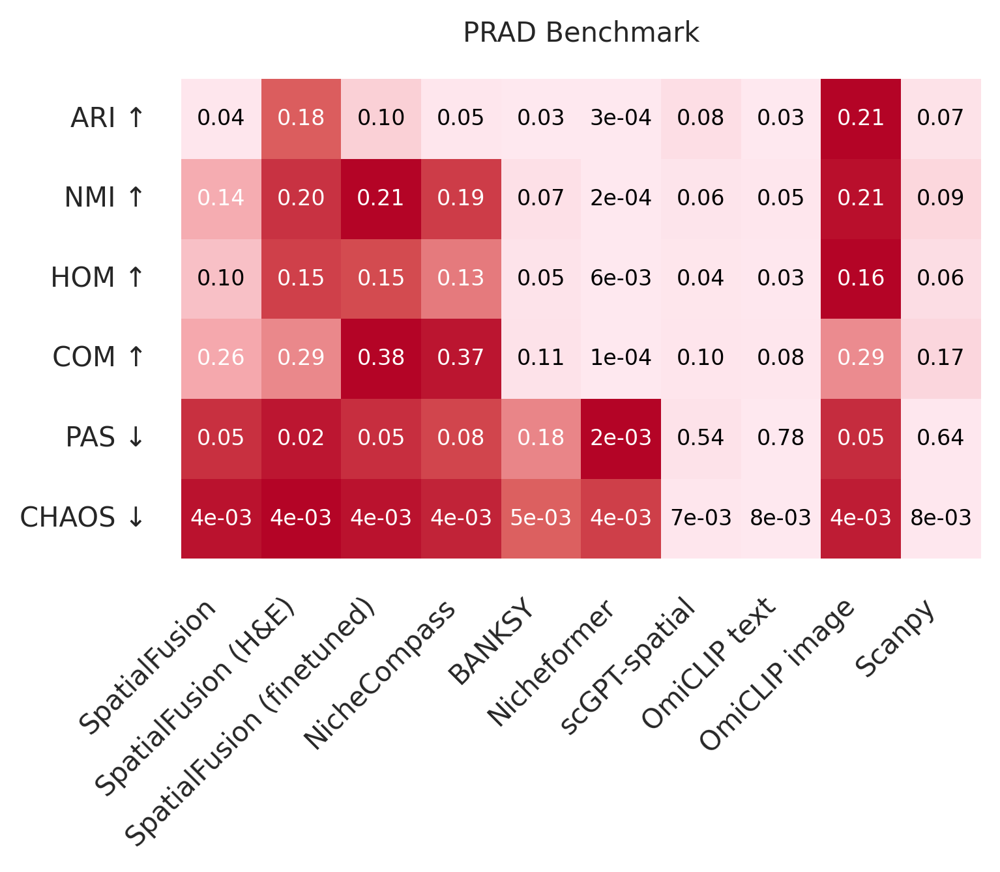

In [152]:
plot_benchmark_heatmap(results_df, title="PRAD Benchmark", savefig='../../../SpatialFusion/results/figures_Fig4/PRAD_benchmark.svg')

## Plot the clusters in space

In [172]:
def plot_spatial_clusters_panel(
    adata,
    method_mapping,
    color_dict,
    coord_keys=("X_coord", "Y_coord"),
    ncols=5,
    savefig=None,
    rasterize_points=True,
):
    """
    Plot spatial clustering panels for multiple methods in a Nature Genetics style.
    """

    x_key, y_key = coord_keys
    method_keys = list(method_mapping.values())
    method_titles = list(method_mapping.keys())
    n_methods = len(method_keys)
    nrows = math.ceil(n_methods / ncols)

    # --- Shared color palette across all cluster IDs (as strings) ---
    all_labels = np.unique(
        np.concatenate([
            adata.obs[k].astype(str).values for k in method_keys
        ])
    )

    # --- Figure style ---
    sns.set_style("white")
    sns.set_context("talk", font_scale=1.3)

    fig, axes = plt.subplots(
        nrows=nrows, ncols=ncols, figsize=(5.5 * ncols, 5 * nrows), dpi=300
    )
    axes = np.array(axes).reshape(-1)

    for i, (display_name, method) in enumerate(method_mapping.items()):
        ax = axes[i]

        # --- Convert hue column to string to match color_dict keys ---
        hue_values = adata.obs[method].astype(str)

        sns.scatterplot(
            x=adata.obs[x_key],
            y=adata.obs[y_key],
            hue=hue_values,
            palette=color_dict[method],
            s=1,
            linewidth=0,
            alpha=0.9,
            ax=ax,
            legend=False,
            rasterized=rasterize_points,
        )

        ax.invert_yaxis()
        ax.set_aspect("equal")

        # --- Titles & styling ---
        ax.set_title(display_name, fontsize=14, fontweight="normal", pad=10)
        ax.set_xlabel("", fontsize=18, labelpad=8, fontweight="normal")
        ax.set_ylabel("", fontsize=18, labelpad=8, fontweight="normal")
        ax.set_xticks([]); ax.set_yticks([])
        for spine in ["top", "right", "left", "bottom"]:
            ax.spines[spine].set_visible(False)
        ax.grid(False)

    # Hide any unused subplots
    for j in range(i + 1, len(axes)):
        axes[j].set_visible(False)

    plt.tight_layout()

    # --- Shared legend ---
    rep_method = list(color_dict.keys())[0]
    rep_palette = color_dict[rep_method]
    
    handles = []
    for label in sorted(all_labels):
        if label in rep_palette:
            handles.append(
                plt.Line2D(
                    [0], [0],
                    marker="o",
                    color="none",
                    markerfacecolor=rep_palette[label],
                    markersize=8,
                    label=label,
                )
            )
    
    legend_fig = plt.figure(figsize=(2.5, 0.4 * len(handles)), dpi=300)
    legend_fig.legend(
        handles=handles,
        loc="center",
        title="Cluster",
        frameon=False,
        ncol=1,
        fontsize=12,
        title_fontsize=14,
    )
    legend_fig.tight_layout()
    
    if savefig:
        fig.savefig(
            f"{savefig}_panel.png",
            dpi=200,
            bbox_inches="tight",
            transparent=True,
        )
        legend_fig.savefig(
            f"{savefig}_legend.svg",
            dpi=300,
            bbox_inches="tight",
            transparent=True,
        )
        print(f"Saved: {savefig}_panel.png and {savefig}_legend.svg")
    
    plt.show()
    plt.close(legend_fig)

In [176]:
leiden_cols = [
       'leiden_gcn', 'leiden_gcn_he', 'leiden_banksy_08',
       'leiden_nichecompass', 'leiden_nicheformer', 'leiden_scgptspatial',
       'leiden_scanpy', 'leiden_omiclip_text',
       'leiden_omiclip_image', 'leiden_gcn_finetuned']

In [177]:
palette_specs = {
            l: tab20_filtered for l in leiden_cols
        }

palette_dict_2 = build_palettes_from_adata(adata, palette_specs)

✅ Built palettes for 10 columns.


Saved: /ewsc/yatesjos/SpatialFusion/results/figures_Fig4/panel_viz_clusters.svg_panel.png and /ewsc/yatesjos/SpatialFusion/results/figures_Fig4/panel_viz_clusters.svg_legend.svg


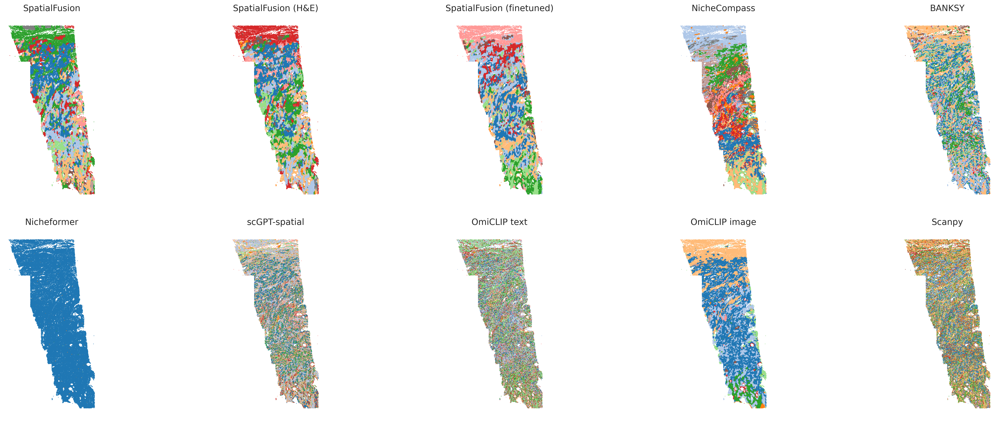

<Figure size 750x1320 with 0 Axes>

In [178]:
method_keys = list(clustering_keys.values())

plot_spatial_clusters_panel(
    adata,
    color_dict=palette_dict_2,
    method_mapping=clustering_keys,
    ncols=5,
    savefig='../../../SpatialFusion/results/figures_Fig4/panel_viz_clusters.svg',
)


# Downstream analysis

## Helper functions

In [179]:
def plot_annotation(
    ax,
    adata,
    column,
    title,
    palette,
    vmin=-5,
    vmax=5,
    x_key="X_he",
    y_key="Y_he",
    point_size=3,
    xlim=None,
    ylim=None,
    colorbar_info=None,
    legends_info=None,
    rasterize_points=True,
):
    """
    Plot an annotation layer (continuous or categorical) in Nature Genetics style.

    Parameters
    ----------
    ax : matplotlib Axes
        Axis to draw on.
    adata : AnnData
        AnnData object containing .obs[column] and coordinates.
    column : str
        Column name in adata.obs to visualize.
    title : str
        Panel title to display.
    palette : str, dict, or colormap
        Palette for categorical data or cmap for continuous data.
    vmin, vmax : float
        Limits for continuous color scaling (clipping).
    x_key, y_key : str
        Keys for spatial coordinates.
    point_size : float
        Scatter point size.
    xlim, ylim : tuple or None
        Manual axis limits if needed.
    colorbar_info : list
        Collects (scatter, title) tuples for later global colorbar plotting.
    legends_info : list
        Collects (title, handles, labels) tuples for separate legends.
    rasterize_points : bool
        Rasterize scatter for smaller vector file size.
    """

    # --- verify column
    if column not in adata.obs.columns:
        raise KeyError(f"Column '{column}' not found in adata.obs")

    values = adata.obs[column]
    if isinstance(values, pd.DataFrame):
        raise ValueError(f"Column '{column}' is not unique in adata.obs (multiple matches)")

    # --- style
    sns.set_style("white")

    # === Continuous variable ===
    if pd.api.types.is_numeric_dtype(values):
        clipped_values = values.clip(lower=vmin, upper=vmax)

        sc = ax.scatter(
            adata.obs[x_key],
            adata.obs[y_key],
            c=clipped_values.values,
            cmap=palette,
            s=point_size,
            alpha=0.8,
            linewidth=0,
            vmin=vmin,
            vmax=vmax,
            rasterized=rasterize_points,
        )

        if colorbar_info is not None:
            colorbar_info.append((sc, title))

    # === Categorical variable ===
    else:
        hue_vals = values.astype(str)

        sns.scatterplot(
            x=adata.obs[x_key],
            y=adata.obs[y_key],
            hue=hue_vals,
            palette=palette,
            s=point_size,
            linewidth=0,
            alpha=0.9,
            ax=ax,
            legend=False,
            rasterized=rasterize_points,
        )

        # collect legend entries for later legend-only figure
        handles, labels = ax.get_legend_handles_labels()
        by_label = {}
        for h, l in zip(handles, labels):
            if l and l != "_nolegend_" and l not in by_label:
                by_label[l] = h
        if legends_info is not None:
            legends_info.append((title, list(by_label.values()), list(by_label.keys())))

    # --- general aesthetics ---
    ax.set_title(title, pad=10)
    ax.set_aspect("equal")
    ax.invert_yaxis()

    if xlim is not None:
        ax.set_xlim(xlim)
    if ylim is not None:
        ax.set_ylim(ylim)

    # no axes, ticks, or spines
    ax.set_xticks([])
    ax.set_yticks([])
    for spine in ["top", "right", "left", "bottom"]:
        ax.spines[spine].set_visible(False)
    ax.grid(False)


## Analysis

In [180]:
source_image_path = '../../../Broad_SpatialFoundation/hest_processed_data/TENX157/Xenium_Prime_Human_Prostate_FFPE_he_image.ome.tif'

with tifffile.TiffFile(source_image_path) as tif:
    wsi = tif.series[0].asarray()


adata.obs['X_he'] = adata.obsm['spatial_he'][:,0]
adata.obs['Y_he'] = adata.obsm['spatial_he'][:,1]

In [181]:
adata.obs['region_annotation'] = adata.obs['region_annotation'].replace({'': 'Unassigned', 'Inflammatory cells;Prostate tumor': 'Inflammatory cells',
                              'Prostate tumor;inflammatory cells': 'Inflammatory cells',
                                                     'Normal prostate glands': 'Normal prostate tissue',
                              'Normal prostate glands;Prostate tumor': 'Normal prostate tissue',
                              'Normal prostate tissue;Prostate tumor': 'Normal prostate tissue'})

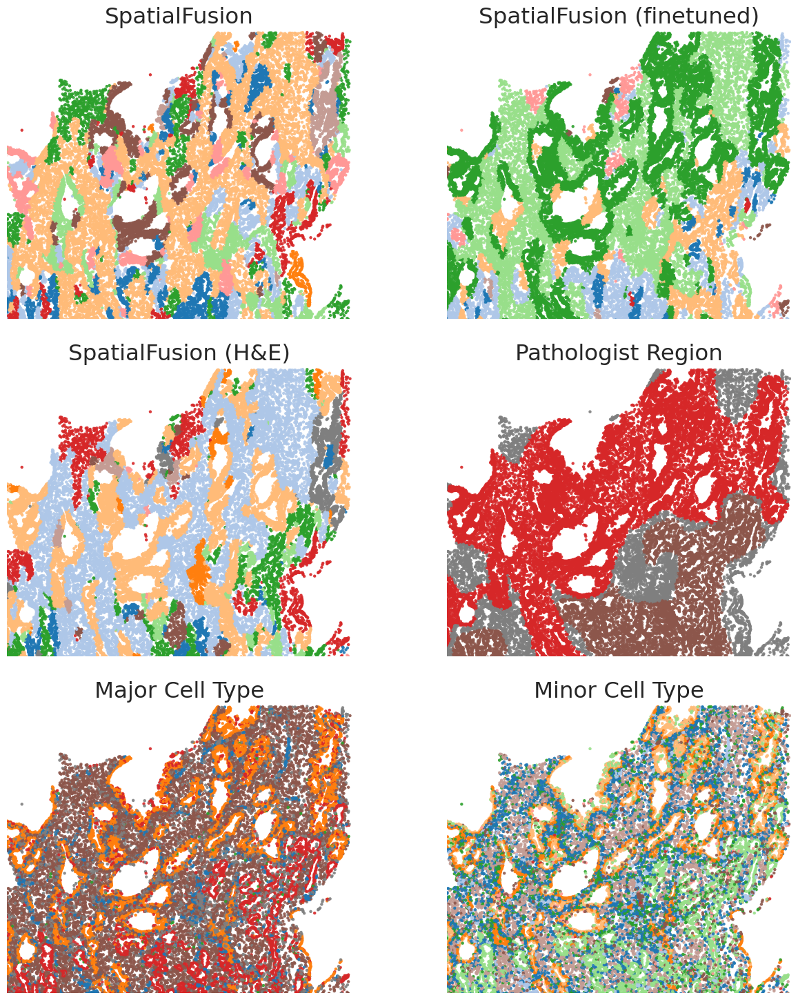

Saved main figure: /ewsc/yatesjos/SpatialFusion/results/figures_Fig4/PRAD_normal_prostate_zoom_panel.svg


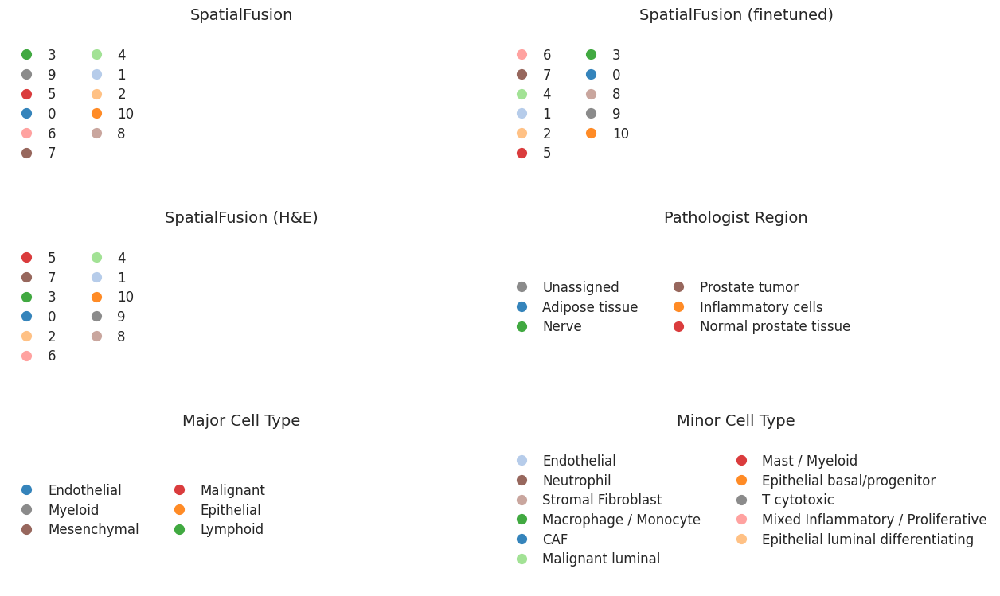

Saved legends: /ewsc/yatesjos/SpatialFusion/results/figures_Fig4/PRAD_normal_prostate_zoom_legends.svg


In [182]:
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd
import numpy as np

# === Parameters ===
xlim = (15000, 24500)
ylim = (40000, 48000)
point_size = 10
figsize = (14, 15)
save_prefix = "../../../SpatialFusion/results/figures_Fig4/PRAD_normal_prostate_zoom"

plot_configs = [
    ("leiden_gcn", "SpatialFusion", palette_dict_2["leiden_gcn"]),
    ("leiden_gcn_finetuned", "SpatialFusion (finetuned)", palette_dict_2["leiden_gcn_finetuned"]),
    ("leiden_gcn_he", "SpatialFusion (H&E)", palette_dict_2["leiden_gcn_he"]),
    ("region_annotation", "Pathologist Region", palette_dict_1["region_annotation"]),
    ("celltypes", "Major Cell Type", palette_dict_1["celltypes"]),
    ("cellsubtypes", "Minor Cell Type", palette_dict_1["cellsubtypes"]),
]


fig, axes = plt.subplots(3, 2, figsize=figsize, sharex=True, sharey=True)
axes = axes.flatten()
legends_info = []


def plot_annotation_wo_HE(ax, column, title, palette):
    """Single Nature Genetics–style scatter panel."""
    hue_vals = adata.obs[column].astype(str)

    # First call with legend=True on a hidden temporary axis to grab handles
    tmp_ax = plt.figure().add_subplot(111)
    sns.scatterplot(
        x=adata.obs["X_he"],
        y=adata.obs["Y_he"],
        hue=hue_vals,
        palette=palette,
        s=point_size,
        ax=tmp_ax,
        linewidth=0,
        alpha=0.9,
        legend=True,
    )
    handles, labels = tmp_ax.get_legend_handles_labels()
    plt.close(tmp_ax.figure)

    # Deduplicate and clean labels
    by_label = {}
    for h, l in zip(handles, labels):
        if l and l != "_nolegend_" and l not in by_label:
            by_label[l] = h
    legends_info.append((title, list(by_label.values()), list(by_label.keys())))

    # Actual subplot (no legend, rasterized)
    sns.scatterplot(
        x=adata.obs["X_he"],
        y=adata.obs["Y_he"],
        hue=hue_vals,
        palette=palette,
        s=point_size,
        ax=ax,
        linewidth=0,
        alpha=0.9,
        legend=False,
        rasterized=True,
    )

    ax.invert_yaxis()
    ax.set_xlim(xlim)
    ax.set_ylim(ylim)
    ax.set_xlabel('')
    ax.set_ylabel('')
    ax.set_aspect("equal")

    ax.set_title(title, pad=6, fontweight="normal")
    ax.set_xticks([]); ax.set_yticks([])
    for spine in ["top", "right", "left", "bottom"]:
        ax.spines[spine].set_visible(False)
    ax.grid(False)


# === Generate main figure ===
for ax, (col, title, pal) in zip(axes, plot_configs):
    plot_annotation_wo_HE(ax, col, title, pal)

plt.tight_layout()
plt.show()

# === Save main panel as lightweight SVG ===
fig.savefig(f"{save_prefix}_panel.svg", dpi=150, bbox_inches="tight", transparent=True)
print(f"Saved main figure: {save_prefix}_panel.svg")


# === Legends-only figure ===
fig_leg, axes_leg = plt.subplots(3, 2, figsize=(figsize[0], 8), squeeze=False)
axes_leg = axes_leg.flatten()

for ax, (title, handles, labels) in zip(axes_leg, legends_info):
    ax.axis("off")
    ax.set_title(f"{title}", fontsize=14, fontweight="normal", pad=6)
    ax.legend(
        handles, labels,
        loc="center left",
        bbox_to_anchor=(0.0, 0.5),
        frameon=False,
        ncol=2,
        handletextpad=0.6,
        labelspacing=0.4,
        borderaxespad=0.0,
        markerscale=3,
        fontsize=12,
    )

plt.tight_layout()
plt.show()

# === Save legends as separate SVG ===
fig_leg.savefig(f"{save_prefix}_legends.svg", dpi=250, bbox_inches="tight", transparent=True)
print(f"Saved legends: {save_prefix}_legends.svg")


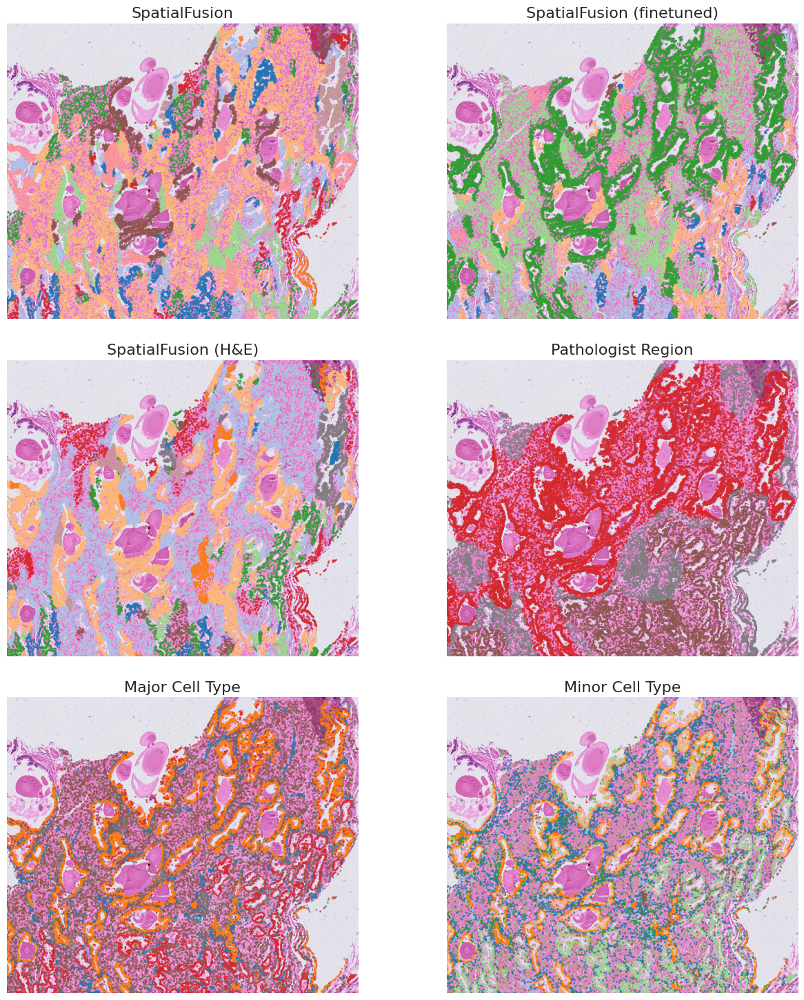

✅ Saved main figure: /ewsc/yatesjos/SpatialFusion/results/figures_Fig4/PRAD_normal_prostate_he_panel.svg


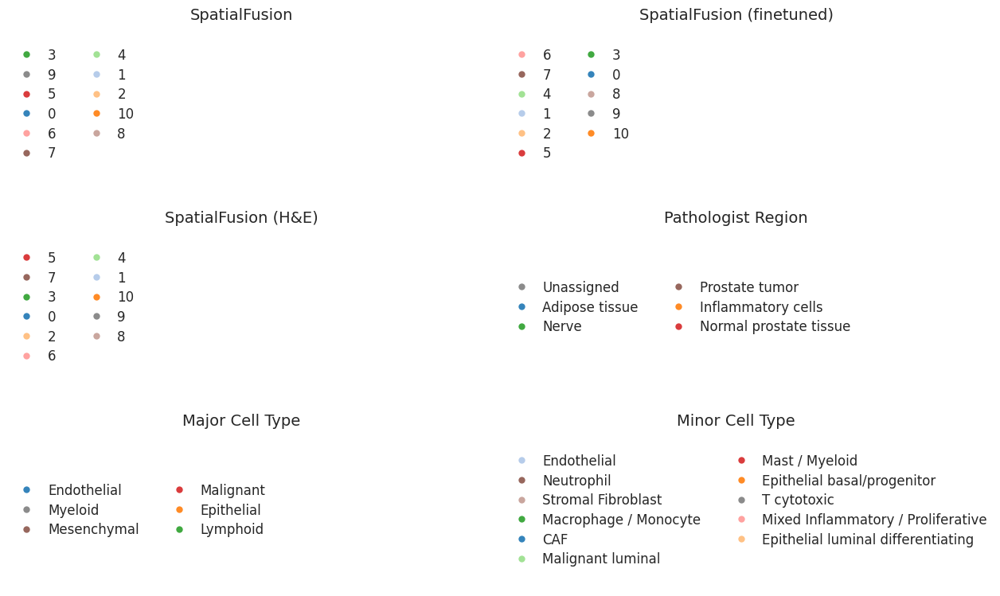

✅ Saved legends: /ewsc/yatesjos/SpatialFusion/results/figures_Fig4/PRAD_normal_prostate_he_legends.svg


In [183]:
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np

# === Parameters ===
xlim = (15000, 24500)
ylim = (40000, 48000)
point_size = 4
figsize = (14, 15)
save_prefix = "../../../SpatialFusion/results/figures_Fig4/PRAD_normal_prostate_he"


# --- Crop region of interest from the H&E image ---
# assume 'wsi' is your RGB numpy array of the full H&E
x0, x1 = xlim
y0, y1 = ylim
roi = wsi[y0:y1, x0:x1, :]  # numpy is row-major (y, x)

# --- Define which columns and palettes to use ---
plot_configs = [
    ("leiden_gcn", "SpatialFusion", palette_dict_2["leiden_gcn"]),
    ("leiden_gcn_finetuned", "SpatialFusion (finetuned)", palette_dict_2["leiden_gcn_finetuned"]),
    ("leiden_gcn_he", "SpatialFusion (H&E)", palette_dict_2["leiden_gcn_he"]),
    ("region_annotation", "Pathologist Region", palette_dict_1["region_annotation"]),
    ("celltypes", "Major Cell Type", palette_dict_1["celltypes"]),
    ("cellsubtypes", "Minor Cell Type", palette_dict_1["cellsubtypes"]),
]

# --- Set up figure grid ---
fig, axes = plt.subplots(3, 2, figsize=figsize, sharex=True, sharey=True)
axes = axes.flatten()
legends_info = []

def plot_annotation_with_HE(ax, column, title, palette):
    """Plot H&E ROI + spatial overlay for one annotation column."""
    hue_vals = adata.obs[column].astype(str)

    # --- capture legend handles (temporary axis) ---
    tmp_ax = plt.figure().add_subplot(111)
    sns.scatterplot(
        x=adata.obs["X_he"], y=adata.obs["Y_he"],
        hue=hue_vals, palette=palette,
        s=point_size, ax=tmp_ax, linewidth=0, alpha=0.9, legend=True,
    )
    handles, labels = tmp_ax.get_legend_handles_labels()
    plt.close(tmp_ax.figure)

    # Deduplicate legend entries
    by_label = {l: h for h, l in zip(handles, labels) if l and l != "_nolegend_"}
    legends_info.append((title, list(by_label.values()), list(by_label.keys())))

    # --- Plot the H&E ROI background ---
    ax.imshow(roi, origin="upper", extent=(x0, x1, y1, y0))  # match tissue coordinates

    # --- Overlay scatter (rasterized for small .svg size) ---
    sns.scatterplot(
        x=adata.obs["X_he"], y=adata.obs["Y_he"],
        hue=hue_vals, palette=palette,
        s=point_size, ax=ax, linewidth=0,
        alpha=0.8, legend=False, rasterized=True,
    )

    # --- Axis and aesthetic setup ---
    ax.set_xlim(x0, x1)
    ax.set_ylim(y1, y0)   # keep consistent orientation
    ax.invert_yaxis()
    ax.set_xlabel('')
    ax.set_ylabel('')
    ax.set_aspect("equal")
    ax.set_title(title, fontsize=16, fontweight="normal", pad=6)
    ax.set_xticks([]); ax.set_yticks([])

    for spine in ["top", "right", "left", "bottom"]:
        ax.spines[spine].set_visible(False)
    ax.grid(False)

# --- Generate panels ---
for ax, (col, title, pal) in zip(axes, plot_configs):
    plot_annotation_with_HE(ax, col, title, pal)

plt.tight_layout()
plt.show()

# === Save main composite figure ===
fig.savefig(f"{save_prefix}_panel.svg", dpi=200, bbox_inches="tight", transparent=True)
print(f"✅ Saved main figure: {save_prefix}_panel.svg")

# === Separate legend figure ===
fig_leg, axes_leg = plt.subplots(3, 2, figsize=(figsize[0], 8), squeeze=False)
axes_leg = axes_leg.flatten()

for ax, (title, handles, labels) in zip(axes_leg, legends_info):
    ax.axis("off")
    ax.set_title(f"{title}", fontsize=14, fontweight="normal", pad=6)
    ax.legend(
        handles, labels,
        loc="center left",
        bbox_to_anchor=(0.0, 0.5),
        frameon=False,
        ncol=2,
        handletextpad=0.6,
        labelspacing=0.4,
        borderaxespad=0.0,
        markerscale=3,
        fontsize=12,
    )

plt.tight_layout()
plt.show()

fig_leg.savefig(f"{save_prefix}_legends.svg", dpi=250, bbox_inches="tight", transparent=True)
print(f"✅ Saved legends: {save_prefix}_legends.svg")


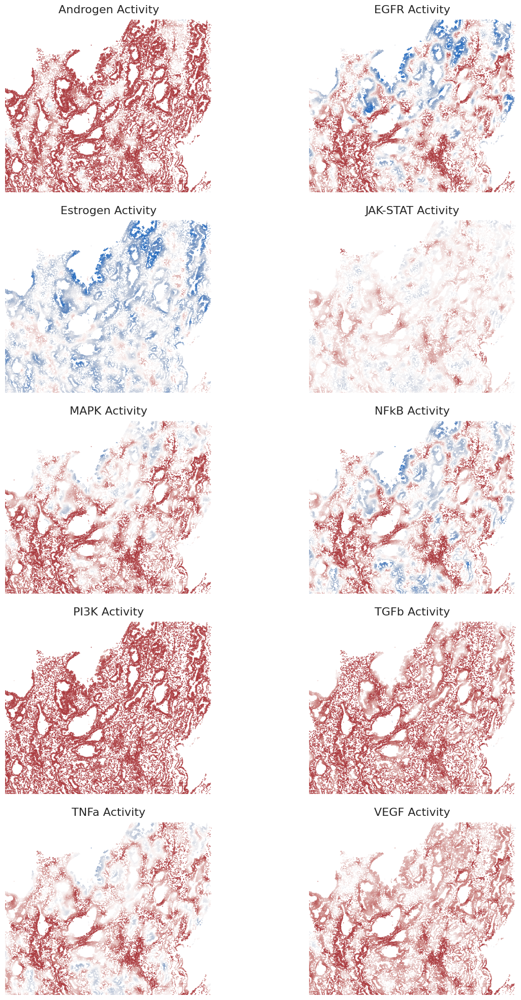

✅ Saved panel: /ewsc/yatesjos/SpatialFusion/results/figures_Fig4/PRAD_pathway_activity_normal_prostate_panel.svg


In [184]:
# === Parameters ===
xlim = (15000, 24500)
ylim = (40000, 48000)
point_size = 3
figsize = (14, 20)
save_prefix = "../../../SpatialFusion/results/figures_Fig4/PRAD_pathway_activity_normal_prostate"

# === Plot settings ===
plot_configs = [
    ("Androgen", "Androgen Activity", "vlag"),
    ("EGFR", "EGFR Activity", "vlag"),
    ("Estrogen", "Estrogen Activity", "vlag"), 
    ("JAK-STAT", "JAK-STAT Activity", "vlag"),
    ("MAPK", "MAPK Activity", "vlag"),
    ("NFkB", "NFkB Activity", "vlag"),
    ("PI3K", "PI3K Activity", "vlag"),
    ("TGFb", "TGFb Activity", "vlag"),
    ("TNFa", "TNFa Activity", "vlag"),
    ("VEGF", "VEGF Activity", "vlag"),
 
]

# === Create subplots ===
fig, axes = plt.subplots(5, 2, figsize=figsize, sharex=True, sharey=True)
axes = axes.flatten()

legends_info = []
colorbar_info = []  # store (ax, column, cmap) for continuous plots

# === Generate plots ===
for ax, (col, title, pal) in zip(axes, plot_configs):
    plot_annotation_pathway(ax, col, title, pal, xlim=xlim,
    ylim=ylim,)

plt.tight_layout()
plt.show()

fig.savefig(f"{save_prefix}_panel.svg", dpi=150, bbox_inches="tight", transparent=True)
print(f"✅ Saved panel: {save_prefix}_panel.svg")

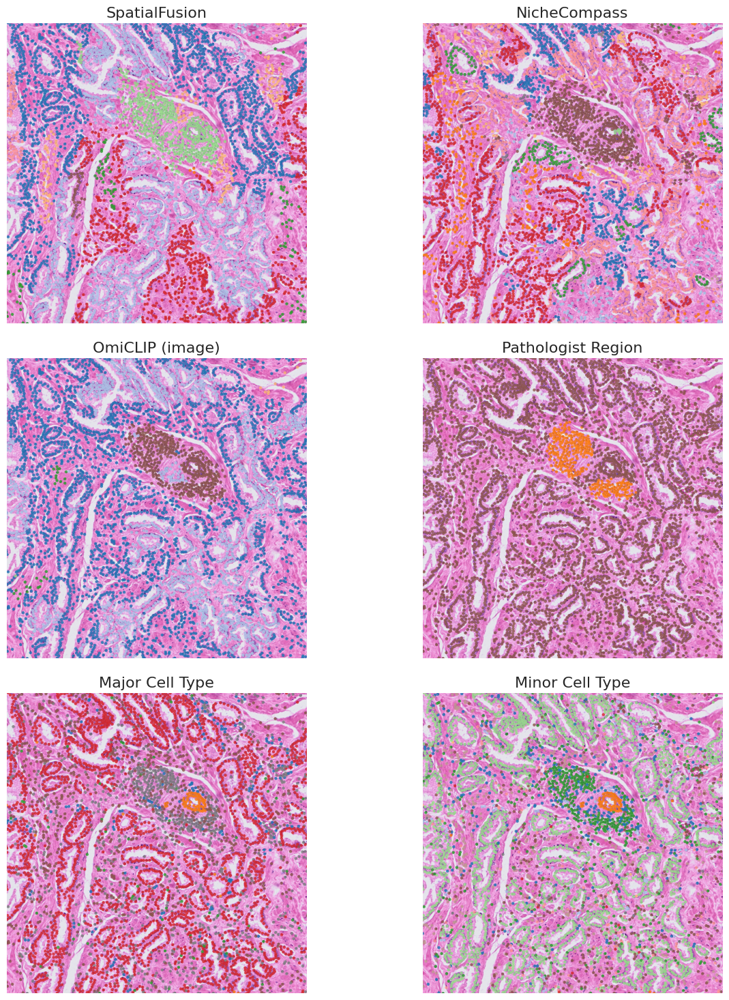

✅ Saved main figure: /ewsc/yatesjos/SpatialFusion/results/figures_Fig4/PRAD_immune_infiltration_1_he_panel.svg


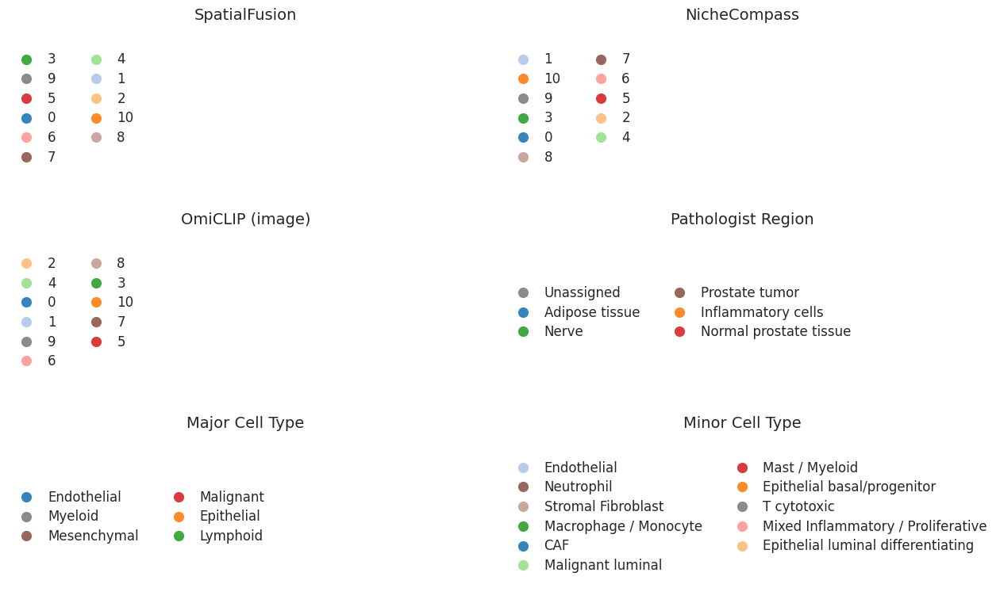

✅ Saved legends: /ewsc/yatesjos/SpatialFusion/results/figures_Fig4/PRAD_immune_infiltration_1_he_legends.svg


In [185]:
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np

# === Parameters ===
xlim = (15500, 18500)
ylim = (26000, 29000)
point_size = 10
figsize = (14, 15)
save_prefix = "../../../SpatialFusion/results/figures_Fig4/PRAD_immune_infiltration_1_he"


# --- Crop region of interest from the H&E image ---
# assume 'wsi' is your RGB numpy array of the full H&E
x0, x1 = xlim
y0, y1 = ylim
roi = wsi[y0:y1, x0:x1, :]  # numpy is row-major (y, x)

# --- Define which columns and palettes to use ---
plot_configs = [
    ("leiden_gcn", "SpatialFusion", palette_dict_2["leiden_gcn"]),
    ("leiden_nichecompass", "NicheCompass", palette_dict_2["leiden_nichecompass"]),
    ("leiden_omiclip_image", "OmiCLIP (image)", palette_dict_2["leiden_omiclip_image"]),
    ("region_annotation", "Pathologist Region", palette_dict_1["region_annotation"]),
    ("celltypes", "Major Cell Type", palette_dict_1["celltypes"]),
    ("cellsubtypes", "Minor Cell Type", palette_dict_1["cellsubtypes"]),
]

# --- Set up figure grid ---
fig, axes = plt.subplots(3, 2, figsize=figsize, sharex=True, sharey=True)
axes = axes.flatten()
legends_info = []

# --- Generate panels ---
for ax, (col, title, pal) in zip(axes, plot_configs):
    plot_annotation_with_HE(ax, col, title, pal)

plt.tight_layout()
plt.show()

# === Save main composite figure ===
fig.savefig(f"{save_prefix}_panel.svg", dpi=200, bbox_inches="tight", transparent=True)
print(f"✅ Saved main figure: {save_prefix}_panel.svg")

# === Separate legend figure ===
fig_leg, axes_leg = plt.subplots(3, 2, figsize=(figsize[0], 8), squeeze=False)
axes_leg = axes_leg.flatten()

for ax, (title, handles, labels) in zip(axes_leg, legends_info):
    ax.axis("off")
    ax.set_title(f"{title}", fontsize=14, fontweight="normal", pad=6)
    ax.legend(
        handles, labels,
        loc="center left",
        bbox_to_anchor=(0.0, 0.5),
        frameon=False,
        ncol=2,
        handletextpad=0.6,
        labelspacing=0.4,
        borderaxespad=0.0,
        markerscale=3,
        fontsize=12,
    )

plt.tight_layout()
plt.show()

fig_leg.savefig(f"{save_prefix}_legends.svg", dpi=250, bbox_inches="tight", transparent=True)
print(f"✅ Saved legends: {save_prefix}_legends.svg")


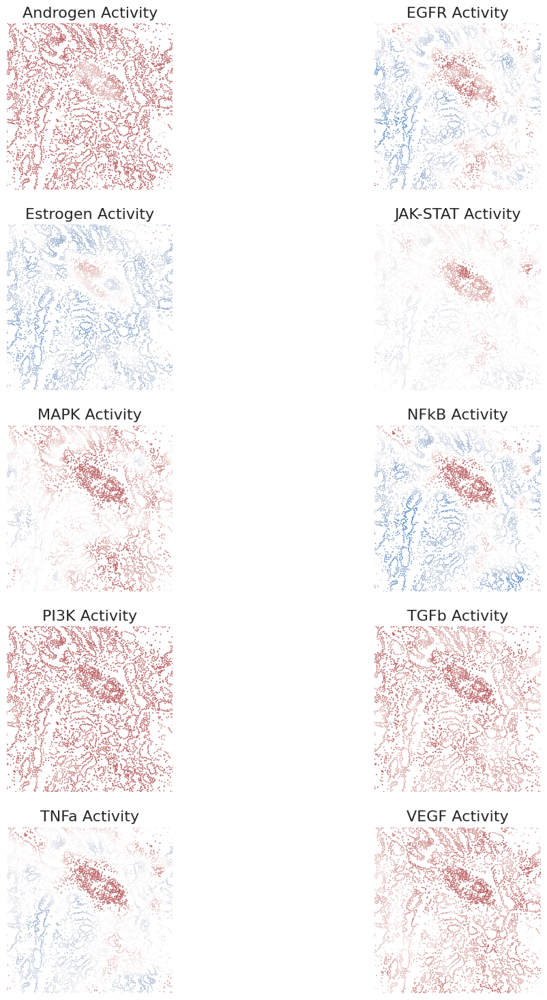

✅ Saved panel: /ewsc/yatesjos/SpatialFusion/results/figures_Fig4/PRAD_pathway_activity_immune_infiltration_1_panel.svg


In [186]:
# === Parameters ===
xlim = (15500, 18500)
ylim = (26000, 29000)
point_size = 10
figsize = (14, 15)
save_prefix = "../../../SpatialFusion/results/figures_Fig4/PRAD_pathway_activity_immune_infiltration_1"

# === Plot settings ===
plot_configs = [
    ("Androgen", "Androgen Activity", "vlag"),
    ("EGFR", "EGFR Activity", "vlag"),
    ("Estrogen", "Estrogen Activity", "vlag"), 
    ("JAK-STAT", "JAK-STAT Activity", "vlag"),
    ("MAPK", "MAPK Activity", "vlag"),
    ("NFkB", "NFkB Activity", "vlag"),
    ("PI3K", "PI3K Activity", "vlag"),
    ("TGFb", "TGFb Activity", "vlag"),
    ("TNFa", "TNFa Activity", "vlag"),
    ("VEGF", "VEGF Activity", "vlag"),
 
]

# === Create subplots ===
fig, axes = plt.subplots(5, 2, figsize=figsize, sharex=True, sharey=True)
axes = axes.flatten()

legends_info = []
colorbar_info = []  # store (ax, column, cmap) for continuous plots

# === Generate plots ===
for ax, (col, title, pal) in zip(axes, plot_configs):
    plot_annotation_pathway(ax, col, title, pal, xlim=xlim,
    ylim=ylim,)

plt.tight_layout()
plt.show()

fig.savefig(f"{save_prefix}_panel.svg", dpi=150, bbox_inches="tight", transparent=True)
print(f"✅ Saved panel: {save_prefix}_panel.svg")

# Co-occurence

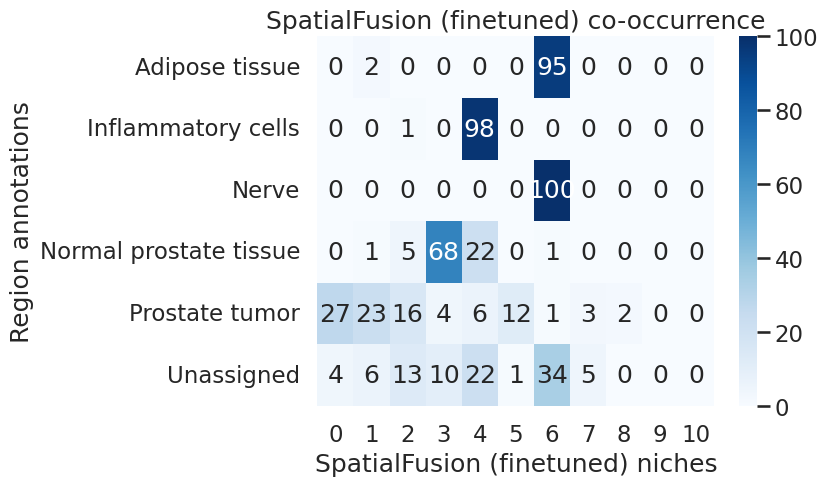

In [103]:
# Step 1: Compute the cross-tabulation (co-occurrence counts)
heatmap_data = pd.crosstab(adata.obs['region_annotation'], adata.obs['leiden_gcn_finetuned'])
heatmap_data = heatmap_data.div(heatmap_data.sum(axis=1), axis=0)*100
heatmap_data = heatmap_data.astype(int)

# Step 2: Plot the heatmap
sns.heatmap(heatmap_data, annot=True, fmt="d", cmap="Blues")
plt.xlabel('SpatialFusion (finetuned) niches')
plt.ylabel('Region annotations')
plt.title('SpatialFusion (finetuned) co-occurrence')
plt.savefig('../../../SpatialFusion/results/figures_Fig4/SpatialFusion_finetuned_confusion.svg', dpi=200, bbox_inches='tight')
plt.show()


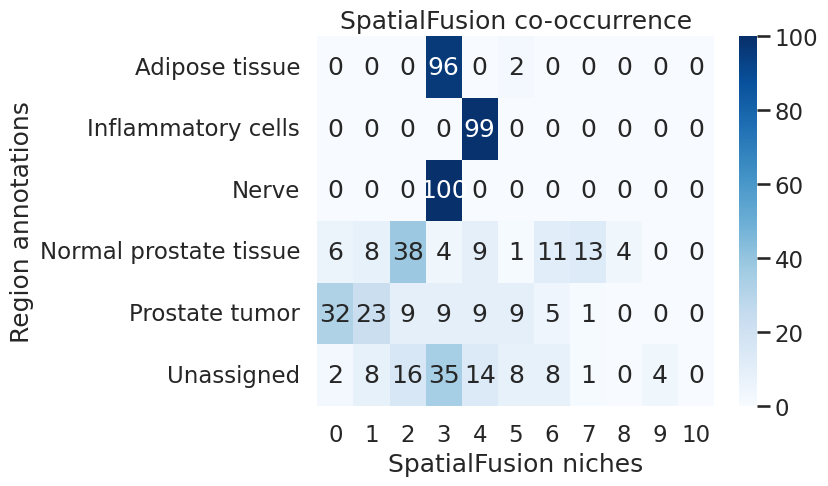

In [187]:
# Step 1: Compute the cross-tabulation (co-occurrence counts)
heatmap_data = pd.crosstab(adata.obs['region_annotation'], adata.obs['leiden_gcn'])
heatmap_data = heatmap_data.div(heatmap_data.sum(axis=1), axis=0)*100
heatmap_data = heatmap_data.astype(int)

# Step 2: Plot the heatmap
sns.heatmap(heatmap_data, annot=True, fmt="d", cmap="Blues")
plt.xlabel('SpatialFusion niches')
plt.ylabel('Region annotations')
plt.title('SpatialFusion co-occurrence')
plt.savefig('../../../SpatialFusion/results/figures_Fig4/SpatialFusion_confusion.svg', dpi=200, bbox_inches='tight')
plt.show()


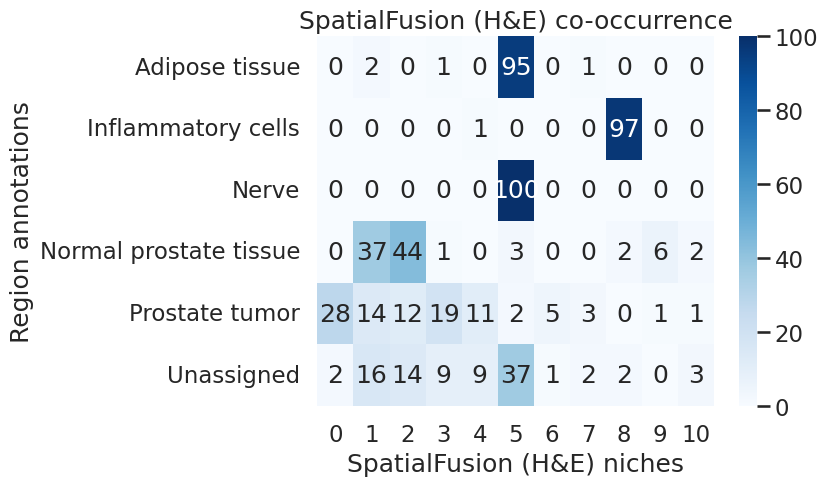

In [188]:
# Step 1: Compute the cross-tabulation (co-occurrence counts)
heatmap_data = pd.crosstab(adata.obs['region_annotation'], adata.obs['leiden_gcn_he'])
heatmap_data = heatmap_data.div(heatmap_data.sum(axis=1), axis=0)*100
heatmap_data = heatmap_data.astype(int)

# Step 2: Plot the heatmap
sns.heatmap(heatmap_data, annot=True, fmt="d", cmap="Blues")
plt.xlabel('SpatialFusion (H&E) niches')
plt.ylabel('Region annotations')
plt.title('SpatialFusion (H&E) co-occurrence')
plt.savefig('../../../SpatialFusion/results/figures_Fig4/SpatialFusion_he_confusion.svg', dpi=200, bbox_inches='tight')
plt.show()


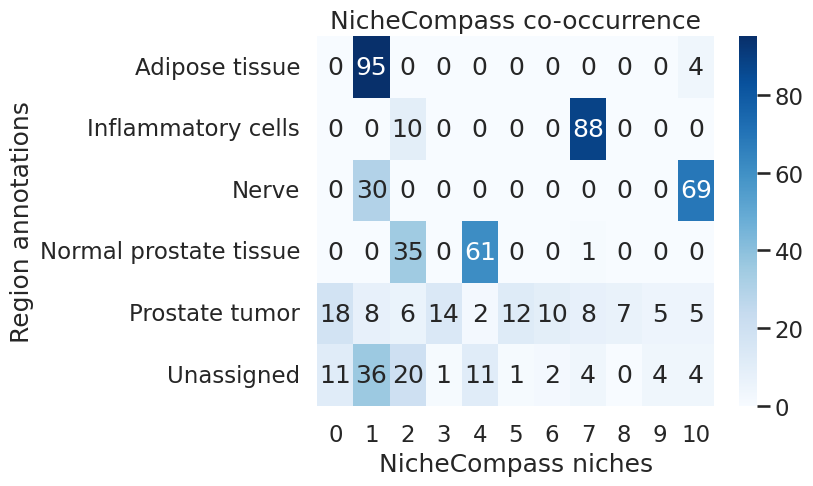

In [189]:
# Step 1: Compute the cross-tabulation (co-occurrence counts)
heatmap_data = pd.crosstab(adata.obs['region_annotation'], adata.obs['leiden_nichecompass'])
heatmap_data = heatmap_data.div(heatmap_data.sum(axis=1), axis=0)*100
heatmap_data = heatmap_data.astype(int)

# Step 2: Plot the heatmap
sns.heatmap(heatmap_data, annot=True, fmt="d", cmap="Blues")
plt.xlabel('NicheCompass niches')
plt.ylabel('Region annotations')
plt.title('NicheCompass co-occurrence')
plt.savefig('../../../SpatialFusion/results/figures_Fig4/NicheCompass_confusion.svg', dpi=200, bbox_inches='tight')
plt.show()


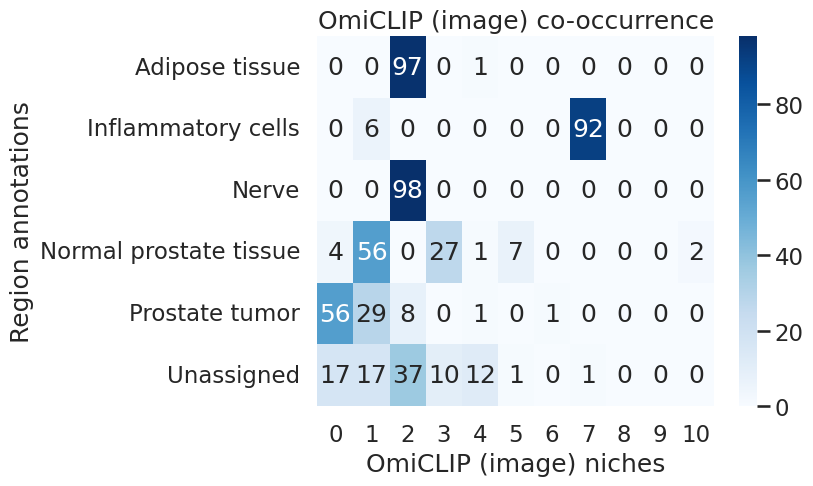

In [190]:
# Step 1: Compute the cross-tabulation (co-occurrence counts)
heatmap_data = pd.crosstab(adata.obs['region_annotation'], adata.obs['leiden_omiclip_image'])
heatmap_data = heatmap_data.div(heatmap_data.sum(axis=1), axis=0)*100
heatmap_data = heatmap_data.astype(int)

# Step 2: Plot the heatmap
sns.heatmap(heatmap_data, annot=True, fmt="d", cmap="Blues")
plt.xlabel('OmiCLIP (image) niches')
plt.ylabel('Region annotations')
plt.title('OmiCLIP (image) co-occurrence')
plt.savefig('../../../SpatialFusion/results/figures_Fig4/OmiCLIP_image_confusion.svg', dpi=200, bbox_inches='tight')
plt.show()


# Cell type composition

In [107]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from typing import Optional, Sequence, Mapping, Tuple, Dict, List
from matplotlib.colors import to_hex, to_rgb
import colorsys


def plot_cluster_composition_stacked(
    df,
    cluster_key: str = "leiden",
    type_key: str = "celltypes",                 # or "cellsubtypes"
    cluster_order: Optional[Sequence[str]] = None,
    strict_order: bool = False,                  # if True, only show clusters in cluster_order
    palette: Optional[Mapping[str, str]] = None, # dict {celltype: color}; auto if None
    top_types: Optional[int] = None,             # keep top N types globally, rest→"Other"
    min_frac: Optional[float] = None,            # keep types with global frac >= min_frac, rest→"Other"
    other_label: str = "Other",
    type_order: Optional[Sequence[str]] = None,  # custom order of stack segments
    figsize=(10, 5),
    percent_labels: bool = False,                # print % on bars
    label_threshold: float = 0.05,               # only label segments >=5%
    savefig: Optional[str] = None,
):
    """
    Plot a 100% stacked barplot of type proportions per cluster using adata.obs.
    Returns a long-form DataFrame with columns: [cluster, type, count, frac, percent]
    """
    obs = df[[cluster_key, type_key]].dropna().copy()
    obs[cluster_key] = obs[cluster_key].astype(str)
    obs[type_key]    = obs[type_key].astype(str)

    # Cross-tab counts (rows=clusters, cols=types)
    ct = pd.crosstab(obs[cluster_key], obs[type_key])

    # Global filtering of rare types (optional)
    keep_cols = ct.columns.tolist()
    if top_types is not None:
        keep_cols = (
            ct.sum(axis=0)
              .sort_values(ascending=False)
              .head(top_types)
              .index.tolist()
        )
    if min_frac is not None:
        global_frac = ct.sum(axis=0) / ct.values.sum()
        keep_cols = sorted(set(keep_cols) | set(global_frac[global_frac >= min_frac].index.tolist()))
    if (top_types is not None) or (min_frac is not None):
        other = ct.drop(columns=keep_cols, errors="ignore").sum(axis=1)
        ct = ct[keep_cols].copy()
        if (other > 0).any():
            ct[other_label] = other
        # make sure "Other" is last
        ct = ct[[c for c in ct.columns if c != other_label] + ([other_label] if other_label in ct.columns else [])]

    # Normalize rows to 1.0 (100%)
    row_sums = ct.sum(axis=1).replace(0, np.nan)
    props = ct.div(row_sums, axis=0).fillna(0.0)

    # Cluster reordering
    if cluster_order is not None:
        cluster_order = [str(c) for c in cluster_order]
        missing = [c for c in cluster_order if c not in props.index]
        if strict_order:
            props = props.reindex(cluster_order).dropna(how="all")
        else:
            extras = [c for c in props.index if c not in cluster_order]
            props = props.reindex(cluster_order + extras)
        if missing:
            print(f"Warning: these clusters from cluster_order were not found and will be skipped: {missing}")
    else:
        props = props.sort_index()

    if props.empty:
        raise ValueError("No clusters to plot after filtering/reordering.")

    # Determine stack (type) order
    types_order = props.columns.tolist()
    if type_order is not None:
        type_order = [t for t in type_order if t in props.columns]
        leftovers = [t for t in props.columns if t not in type_order]
        types_order = type_order + leftovers

    # Build color map
    if palette is None:
        base = sns.color_palette("tab10", n_colors=max(10, len(types_order)))
        colmap = dict(zip(types_order, base[:len(types_order)]))
        if other_label in types_order:
            colmap[other_label] = "#B0B0B0"  # gray for "Other"
    else:
        colmap = {t: palette.get(t, "#BBBBBB") for t in types_order}

    # Plot (stacked bars)
    plt.figure(figsize=figsize)
    bottom = np.zeros(len(props))
    x = np.arange(len(props.index))
    ax = plt.gca()

    for t in types_order:
        vals = props[t].values
        ax.bar(x, vals, bottom=bottom, width=0.9, color=colmap[t], label=t, edgecolor="none")
        bottom += vals

    ax.set_xticks(x)
    ax.set_xticklabels(props.index, rotation=45, ha="right")
    ax.set_ylim(0, 1)
    ax.set_ylabel("Composition (% of cells)")
    ax.set_xlabel(cluster_key)
    ax.set_title(f"{type_key} composition per {cluster_key}")

    if percent_labels:
        for i, cl in enumerate(props.index):
            cum = 0.0
            for t in types_order:
                h = props.loc[cl, t]
                if h >= label_threshold:
                    ax.text(i, cum + h/2, f"{h*100:.0f}%", ha="center", va="center", fontsize=8, color="white")
                cum += h

    ax.legend(bbox_to_anchor=(1.02, 1), loc="upper left", title=type_key)
    plt.tight_layout()

    if savefig:
        plt.savefig(savefig, dpi=200, bbox_inches='tight')
    plt.show()

    # Long-form result for downstream use
    plot_df = (
        props.reset_index()
             .melt(id_vars=cluster_key, var_name="type", value_name="frac")
             .rename(columns={cluster_key: "cluster"})
    )
    plot_df["percent"] = (plot_df["frac"] * 100).round(2)
    counts_long = (
        ct.reset_index()
          .melt(id_vars=cluster_key, var_name="type", value_name="count")
          .rename(columns={cluster_key: "cluster"})
    )
    plot_df = plot_df.merge(counts_long, on=["cluster", "type"], how="left")
    return plot_df

def _lightness_shades(base_color, n, l_low=0.35, l_high=0.85):
    """Generate a sequence of lighter shades from a base color."""
    rgb = to_rgb(base_color)
    h, l, s = colorsys.rgb_to_hls(*rgb)
    ls = np.linspace(l_low, l_high, n)
    shades = [to_hex(colorsys.hls_to_rgb(h, li, s)) for li in ls]
    return shades

def make_hierarchical_palettes(
    df,
    parent_key: str = "celltypes",
    child_key: str  = "cellsubtypes",
    parent_order: Optional[Sequence[str]] = None,
    child_order: str = "alpha",
    base_palette: Optional[Mapping[str, str]] = None,  # legacy param
    parent_palette_dict: Optional[Dict[str, Tuple[float, float, float]]] = None,  # ✅ new
    unknown_parent_color: str = "#9e9e9e",
    shade_lightness: Tuple[float, float] = (0.35, 0.85),
) -> Tuple[Dict[str, str], Dict[str, str], List[str], List[str]]:
    """
    Generate hierarchical palettes with optional parent palette override.

    Parameters
    ----------
    parent_palette_dict : dict, optional
        If provided, should be {parent_label: color (hex or RGB)}.
        These colors are used directly for parent_palette and for shading.

    Returns
    -------
    parent_palette : {parent -> hex}
    child_palette  : {child -> hex}
    parent_order_out : list of parents
    child_order_out  : list of children grouped by parent
    """
    obs = df[[parent_key, child_key]].copy()
    obs[parent_key] = obs[parent_key].astype(str)
    obs[child_key]  = obs[child_key].astype(str)

    # --- Parent order ---
    parents = obs[parent_key].unique().tolist()
    if parent_order is not None:
        parent_order_out = [p for p in parent_order if p in parents] + \
                           [p for p in parents if p not in parent_order]
    else:
        freq = obs[parent_key].value_counts()
        parent_order_out = freq.index.tolist() + [p for p in parents if p not in freq.index]

    # --- Children per parent ---
    children_per_parent = {}
    for p in parents:
        sub = obs.loc[obs[parent_key] == p, child_key]
        if child_order == "freq":
            children = sub.value_counts().index.tolist()
        else:
            children = sorted(sub.unique().tolist())
        children_per_parent[p] = children

    # --- Build parent colors ---
    if parent_palette_dict is not None:
        # ✅ use directly, fallback to gray if missing
        parent_palette = {
            p: to_hex(parent_palette_dict.get(p, unknown_parent_color))
            for p in parent_order_out
        }
    elif base_palette is not None:
        parent_palette = {p: base_palette.get(p, unknown_parent_color) for p in parent_order_out}
    else:
        n_par = len(parent_order_out)
        base = sns.color_palette("tab10" if n_par <= 10 else "hls", n_colors=n_par)
        parent_palette = {p: to_hex(base[i]) for i, p in enumerate(parent_order_out)}

    # --- Build child colors as shades of parent ---
    l_low, l_high = shade_lightness
    child_palette = {}
    child_order_out = []
    for p in parent_order_out:
        base_col = parent_palette.get(p, unknown_parent_color)
        kids = children_per_parent.get(p, [])
        if not kids:
            continue
        shades = _lightness_shades(base_col, len(kids), l_low, l_high)
        for k, col in zip(kids, shades):
            child_palette[k] = col
        child_order_out.extend(kids)

    return parent_palette, child_palette, parent_order_out, child_order_out



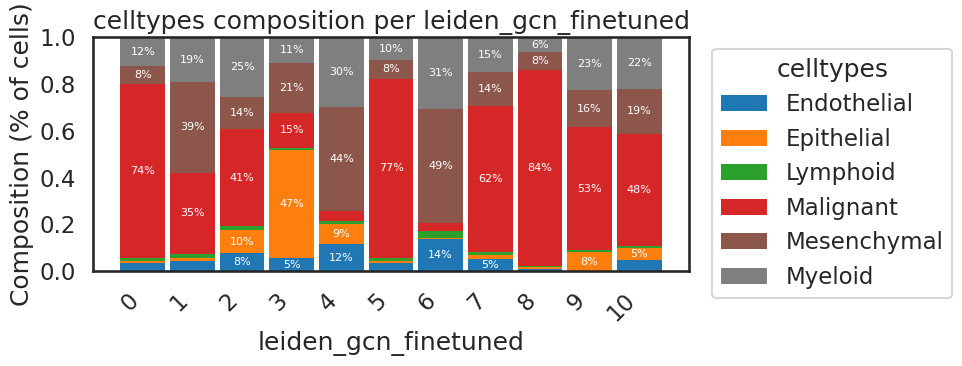

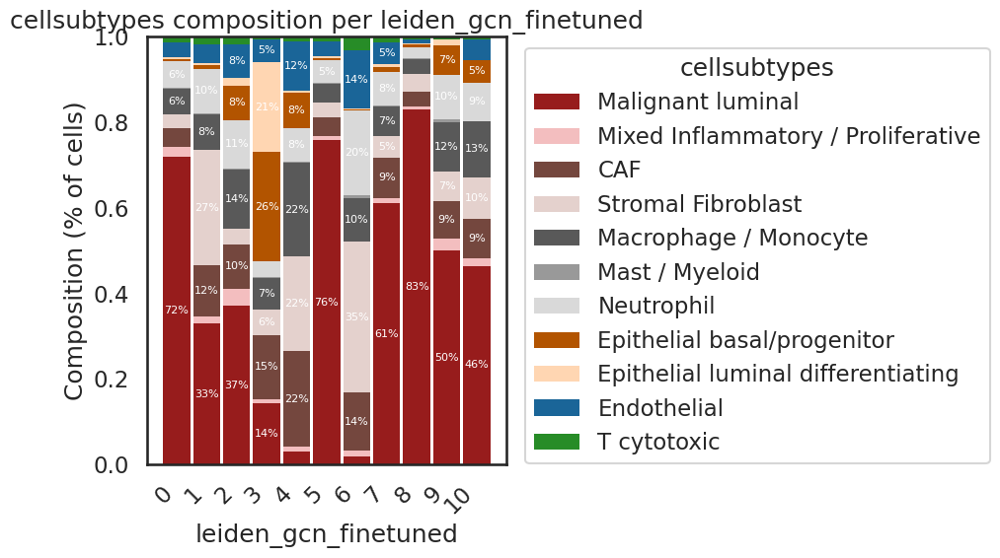

In [108]:
# Build coherent palettes & orders
parent_pal, child_pal, parent_order, child_order = make_hierarchical_palettes(
    adata.obs,
    parent_key="celltypes",
    child_key="cellsubtypes",
    parent_palette_dict=palette_dict_1['celltypes'],
    child_order="alpha",                 # or "freq"
    shade_lightness=(0.35, 0.85)
)

# (A) 100% stacked bars by lineage (coarse)
plot_df_types = plot_cluster_composition_stacked(
    adata.obs,
    cluster_key="leiden_gcn_finetuned",
    type_key="celltypes",
    cluster_order=["0","1","2","3","4","5","6","7","8","9","10",],  # your preferred cluster order
    strict_order=False,
    palette=parent_pal,
    percent_labels=True,
    figsize=(10, 4),
    savefig='../../../SpatialFusion/results/figures_Fig4/PRAD_major_celltype_stacked_finetuned_barplot.svg',
)

# (B) 100% stacked bars by subtypes (fine), colors are shades within lineage color
plot_df_subtypes = plot_cluster_composition_stacked(
    adata.obs,
    cluster_key="leiden_gcn_finetuned",
    type_key="cellsubtypes",
    cluster_order=["0","1","2","3","4","5","6","7","8","9","10",],
    strict_order=False,
    palette=child_pal,
    # NEW: order subtypes grouped by their parent lineage
    type_order=child_order,              # requires tiny tweak shown above
    percent_labels=True,
    figsize=(10, 6),
    savefig='../../../SpatialFusion/results/figures_Fig4/PRAD_minor_celltype_stacked_finetuned_barplot.svg',
)
